<div style="width:100%; height:140px">
    <img src="https://www.kuleuven.be/internationaal/thinktank/fotos-en-logos/ku-leuven-logo.png/image_preview" width = 300px, heigh = auto align=left>
</div>

KUL H02A5a Computer Vision: Group Assignment 1
---------------------------------------------------------------

Student numbers: r0845342, r0381753, r0632041, r0431429

---------------------------------------------------------------

In this Tutorial we will explore techniques for constructing features that describe (facial) objects of interest and perform face recognition using these features. The tutorial is constructed for readers to follow our (Python) code and the end results will be directly viewable in the kaggle competition on face recognition. More specifically, we will walk through the whole code step by step and provide elaborate discussion where relevant. This tutorial is structured as follows:

0. Import Packages, Load Data and Data Pre-processing
1. Facial Feature Representations
2. Evaluation Metrics of Facial Features
3. Facial Image Classifiers
4. Experiments
5. Discussion and Publishing of the Results

We start with importing the necessary Python packages and loading the image data where we make a split between a training and test set. We pre-process the raw data in order to make it ready for analysis. First we extract/represent facial features and then we run (machine learning based) classifiers on them. We also run some experiments. Finally we discuss our results and publish them in the kaggle competition. 
    
This is an introductory tutorial for graduate level students to get a brief introduction and hands-on experience with machine learning technique for face recognition. We hope that you enjoy this tutorial!

---------------------------------------------------------------

# 0. Import Packages, Load Data and Data Pre-processing
    
## 0.0. Import Packages

For the purpose of this tutorial we will work with Python. One of the big advantages of Python is its large library of (external) packages which are developed and maintained by the community. More specifically, there is a large selection of packages for machine learning which makes Python the go-to programming language for practical machine learning applications. For this tutorial we load/import several packages including numpy for mathematical operations, pandas for data processing, matplot for plotting, and Open CV/Scikit-Learn/FaceNet for machine learning.

---------------------------------------------------------------


In [1]:
import io # Input/Output Module
import os # OS interfaces
import cv2 # OpenCV package
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import sys # system commands
from urllib import request # module for opening HTTP requests
from matplotlib import pyplot as plt # Plotting library
import matplotlib # Plotting library
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.metrics import confusion_matrix, classification_report
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from sklearn.preprocessing import Normalizer
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score
import dlib
from sklearn import svm
from numpy import ceil
!pip install facenet-pytorch
from facenet_pytorch import MTCNN, InceptionResnetV1
import torch
from torchvision.transforms import functional as F
def downloadFile(url,file):
    with request.urlopen(url) as r, open(file, 'wb') as f:
        f.write(r.read())
import warnings
warnings.filterwarnings("ignore")

     |████████████████████████████████| 1.9 MB 412 kB/s 


## 0.1. Import data
We import the data which is in csv files via die pandas csv reader. When we load the data, we split the data sample into 1) train data sample and 2) test data sample. The train data sample will be used to train our face recognition system and the test data sample will be used to test our face recognition system. The results on the test data are used in the Kaggle competition. Note that this dataset is a subset of the [*VGG face dataset*](https://www.robots.ox.ac.uk/~vgg/data/vgg_face/) which is a popular data set of faces used for face recognition. 

---------------------------------------------------------------



In [2]:
# Steffi contributed to this part
# Input data files are available in the read-only "../input/" directory
# import train data
train = pd.read_csv(
    '/kaggle/input/kul-h02a5a-computervision-groupassignment0/train_set.csv', index_col = 0)
train.index = train.index.rename('id')

# import test data
test = pd.read_csv(
    '/kaggle/input/kul-h02a5a-computervision-groupassignment0/test_set.csv', index_col = 0)
test.index = test.index.rename('id')

# read the images as numpy arrays and store in "img" column
train['img'] = [cv2.cvtColor(np.load('/kaggle/input/kul-h02a5a-computervision-groupassignment0/train/train/train_{}.npy'.format(index), allow_pickle=False), cv2.COLOR_BGR2RGB) 
                for index, row in train.iterrows()]

test['img'] = [cv2.cvtColor(np.load('/kaggle/input/kul-h02a5a-computervision-groupassignment0/test/test/test_{}.npy'.format(index), allow_pickle=False), cv2.COLOR_BGR2RGB) 
                for index, row in test.iterrows()]

The training set contains 80 objects while the test set contains 1816 objects. The training set is thus many times smaller than the test set and this might strike you as odd, however, this is close to a real world scenario where your system might be put through daily use! Realistically, researchers usually tend to only have limited samples and should make systems/algorithms being able to learn from these limited samples. In this tutorial we will try to do the best we can with the data that we've got!!

## 0.2. A First Look At The Data

First thing to do is to analyse the data to get a first view of what we are dealing with.

We find that the training data contains an identifier, name, image information and class label while the test set only contains an identifier and corresponding image information. Further, we look at the class distribution of the training set to get a feel of the data we are dealing with

In [3]:
# The training set contains an identifier, name, image information and class label
train.head()

,name,class,img
id,,,
0,Mila_Kunis,2,"[[[50, 31, 25], [49, 30, 24], [49, 30, 24], [4..."
1,Mila_Kunis,2,"[[[24, 35, 31], [25, 36, 32], [27, 36, 33], [2..."
2,Michael_Cera,0,"[[[111, 112, 106], [111, 112, 106], [112, 113,..."
3,Mila_Kunis,2,"[[[223, 223, 223], [223, 223, 223], [223, 223,..."
4,Michael_Cera,0,"[[[195, 195, 205], [195, 195, 205], [190, 192,..."


In [4]:
# The test set only contains an identifier and corresponding image information.
test.head()

,img
id,
0,"[[[209, 210, 205], [208, 209, 204], [208, 209,..."
1,"[[[146, 113, 36], [147, 114, 37], [147, 114, 3..."
2,"[[[194, 192, 193], [194, 192, 193], [193, 193,..."
3,"[[[121, 121, 121], [121, 121, 121], [121, 121,..."
4,"[[[228, 228, 230], [228, 228, 230], [228, 228,..."


In [5]:
# The class distribution in the training set:
train.groupby('name').agg({'img':'count', 'class': 'max'})

,img,class
name,,
Jesse_Eisenberg,30,1
Michael_Cera,10,0
Mila_Kunis,30,2
Sarah_Hyland,10,0


We find that there are images of 4 people: Jesse (30 images), Michael (10 images), Mila (30 images) and Sarah (10 images). Note that **Jesse is assigned the classification label 1**, and **Mila is assigned the classification label 2**. The dataset also contains 20 images of **look alikes (assigned classification label 0)** and the raw images. Now we know with what kind of data we are dealing with, we can go to the data pre-processing stage.


## 0.3. Data Preprocessing

The data pre-processing stage is an important part of any machine learning application. For the purpose of face recognition, data pre-processing is a very important step as the images need to be standardized in a certain way and faces need to be recognized. We start with HAAR face detector and try several alternatives to this such as DNN, CNN and MTCNN. We augment the training data by rotating the face images, we extract/split the face images where there are multiple faces in one image, and we remove images not containing any faces. 

---------------------------------------------------------------
***visualization & plotting***

In [6]:
FACE_SIZE = (100, 100)

def plot_image_sequence(data, n, imgs_per_row=7):
    n_rows = int(ceil(n/(imgs_per_row)))
    n_cols = min(imgs_per_row, n)

    f,ax = plt.subplots(n_rows,n_cols, figsize=(10*n_cols,10*n_rows))
    for i in range(n):
        if n == 1:
            ax.imshow(data[i])
        elif n_rows > 1:
            ax[int(i/imgs_per_row),int(i%imgs_per_row)].imshow(data[i])
        else:
            ax[int(i%n)].imshow(data[i])
    plt.show()

### 0.3.1 Data augmentation

We augment the data set to 1) expand the data set, 2) introduce slight variations. This would improve training of the algorithms. Here we rotate training images with -8, -4, + 4 and +8 degrees and as a result we go from 80 to 400 training images

**Code**

Below we provide the code

In [7]:
# Steffi contributed to this part
def rotation(img, angle):
    h, w = img.shape[:2]
    M = cv2.getRotationMatrix2D((int(w/2), int(h/2)), angle, 1)
    img = cv2.warpAffine(img, M, (w, h))
    return img


def augment_data(train):
    for index, row in train.iterrows():
        newRowA = row.copy(deep=True)
        newRowA.img = rotation(newRowA.img, 8)
        train = train.append(newRowA)

        newRowB = row.copy(deep=True)
        newRowB.img = rotation(newRowB.img, 4)
        train = train.append(newRowB)

        newRowC = row.copy(deep=True)
        newRowC.img = rotation(newRowC.img, -4)
        train = train.append(newRowC)

        newRowD = row.copy(deep=True)
        newRowD.img = rotation(newRowD.img, -8)
        train = train.append(newRowD)
        
    return train

train = augment_data(train)

### 0.3.2 HAAR face detector

In the basic case we use the [HAAR feature based cascade classifiers](https://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_objdetect/py_face_detection/py_face_detection.html) from OpenCV to detect faces and then the faces are resized so that they all have the same shape. OpenCV (Open Source Computer Vision Library) is a specialized computer vision library and contains many useful algorithms including the HAAR face detector (face detection using Haar Cascades). Object detection using the Haar feature-based cascade classifiers is an effective object detection that can be used for facial features. The cascade function is trained from positive (face) and negative (no face) images, and this is used as a classifier to extract many features where the best ones are selected via the Adaboost algorithm, and use the concept of Cascade of Classifiers where features are grouped and non-face windows are filtered out. Haar cascades require a lot of positive and negative training images to train - these cascades come with opencv along with the trained XML files.

To keep things easy, if there are multiple faces in an image then we only take the first one (we will relax this assumption later and introduce a more advanced methodology). 

**Code HAAR processor**

Below we provide code for the preprocessing pipeline around the HAAR processor.

In [8]:
class HAARPreprocessor():
    """Preprocessing pipeline built around HAAR feature based cascade classifiers. """
    
    def __init__(self, path, face_size):
        self.face_size = face_size
        file_path = os.path.join(path, "haarcascade_frontalface_default.xml")
        if not os.path.exists(file_path): 
            if not os.path.exists(path):
                os.mkdir(path)
            self.download_model(file_path)
        
        self.classifier = cv2.CascadeClassifier(file_path)
  
    def download_model(self, path):
        url = "https://raw.githubusercontent.com/opencv/opencv/master/data/"\
            "haarcascades/haarcascade_frontalface_default.xml"
        
        with request.urlopen(url) as r, open(path, 'wb') as f:
            f.write(r.read())
            
    def detect_faces(self, img):
        """Detect all faces in an image."""
        
        img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        return self.classifier.detectMultiScale(
            img_gray,
            scaleFactor=1.2,
            minNeighbors=5,
            minSize=(30, 30),
            flags=cv2.CASCADE_SCALE_IMAGE
        )
        
    def extract_faces(self, img):
        """Returns all faces (cropped) in an image."""
        
        faces = self.detect_faces(img)

        return [img[y:y+h, x:x+w] for (x, y, w, h) in faces]
    
    def preprocess(self, data_row):
        faces = self.extract_faces(data_row['img'])
        
        # if no faces were found, return None
        if len(faces) == 0:
            nan_img = np.empty(self.face_size + (3,))
            nan_img[:] = np.nan
            return nan_img
        
        # only return the first face
        return cv2.resize(faces[0], self.face_size, interpolation = cv2.INTER_AREA)
            
    def __call__(self, data):
        return np.stack([self.preprocess(row) for _, row in data.iterrows()]).astype(int)

**Visualise**

Let's plot the results (find code below) 

Dopplegangers


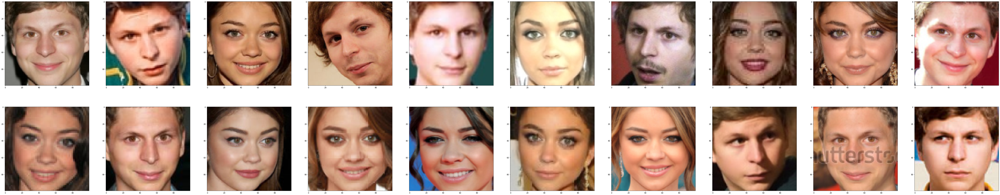

Jess


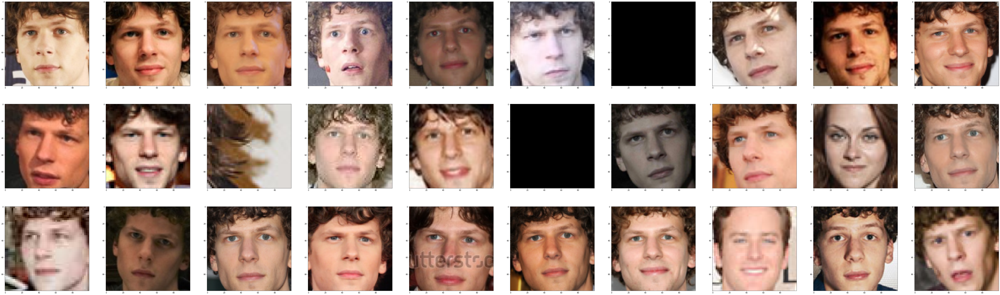

Mila


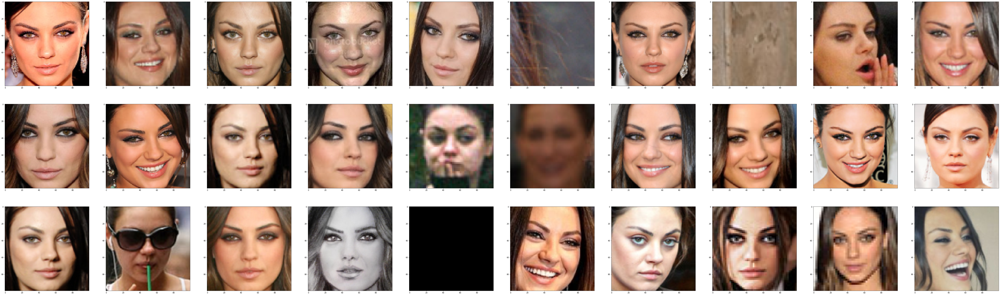

In [9]:
# preprocessed data 
preprocessor = HAARPreprocessor(path = '../../tmp', face_size = FACE_SIZE)

train_X, train_y = preprocessor(train), train['class'].values
#test_X = preprocessor(test)

#Plot Faces
print("Dopplegangers")
plot_image_sequence(train_X[train_y == 0], n=20, imgs_per_row=10)
print("Jess")
plot_image_sequence(train_X[train_y == 1], n=30, imgs_per_row=10)
print("Mila")
plot_image_sequence(train_X[train_y == 2], n=30, imgs_per_row=10)

### 0.3.3 Alternative 1: DNN Face Detector

The Haar face detector was the go-to in Face Detection for many years, however, there has been many improvements in the recent years. We provide DNN as a first alternative to the HAAR face detector which is also available in OpenCV. DNN is Deep Neural Network based on a Caffe framework which is based on the Single Shot-Multibox Detector (SSD). Deep neural networks generally provide more flexibility which is needed when there is a non-standardized data environment as tends to be the case with image data. The DNN face detector solve several drawbacks of the Haar detector without compromising on any of the advantages. Some recent papers have shown its superiority relative to the Haar processor. It works for different face orientations, under substantial occlusion, and detects faces across various scales. The algorithm can be found in the the OpenCV library in Python. 

**Code DNN processor**

Below we provide code for the preprocessing pipeline around the DNN processor.

In [10]:
# Steffi contributed to this part
class DNNPreprocessor():
    def __init__(self, path, face_size):
        self.face_size = face_size
        modelFile = "opencv_face_detector_uint8.pb"
        configFile = "opencv_face_detector.pbtxt"
        downloadFile("https://raw.githubusercontent.com/spmallick/learnopencv/master/AgeGender/opencv_face_detector.pbtxt",configFile)
        downloadFile("https://raw.githubusercontent.com/spmallick/learnopencv/1b1c76fbe2d06c86d595fd23a9ba33725cff4ccd/AgeGender/opencv_face_detector_uint8.pb",modelFile)
        self.net = cv2.dnn.readNetFromTensorflow(modelFile, configFile)
    def return_blob(self, img):
        return cv2.dnn.blobFromImage(cv2.resize(img, (300, 300)), 1.0, (300, 300), (104.0, 177.0, 123.0),False, False)
    def detect_faces(self, img):
        blob = self.return_blob(img)
        self.net.setInput(blob)
        return self.net.forward()
    
    def extract_faces(self, img):
        conf_threshold = 0.5
        max_confidence = 0
        """Returns all faces (cropped) in an image."""
        (frameHeight, frameWidth) = img.shape[:2]
        detections = self.detect_faces(img)
        x1 = 0
        x2 = 0
        y1 = 0
        y2 = 0
        #select face with largest confidence
        for i in range(detections.shape[2]):
            confidence = detections[0, 0, i, 2]      
            if confidence > conf_threshold:
                if confidence > max_confidence:
                    max_confidence = confidence
                    x1 = int(detections[0, 0, i, 3] * frameWidth)
                    y1 = int(detections[0, 0, i, 4] * frameHeight)
                    x2 = int(detections[0, 0, i, 5] * frameWidth)
                    y2 = int(detections[0, 0, i, 6] * frameHeight)             
        return img[y1:y2, x1:x2]
    def preprocess(self, data_row):
        face = self.extract_faces(data_row['img'])

        # if no faces were found, return None
        if len(face) == 0 or np.isin(0,np.shape(face)):
            face = np.empty(self.face_size + (3,))
            face[:] = np.nan

        # try:
        return cv2.resize(face, self.face_size, interpolation=cv2.INTER_AREA)
    def __call__(self, data):
        return np.stack([self.preprocess(row) for _, row in data.iterrows()]).astype(int)

**Visualise**

Let's plot the results (find code below) 

Dopplegangers


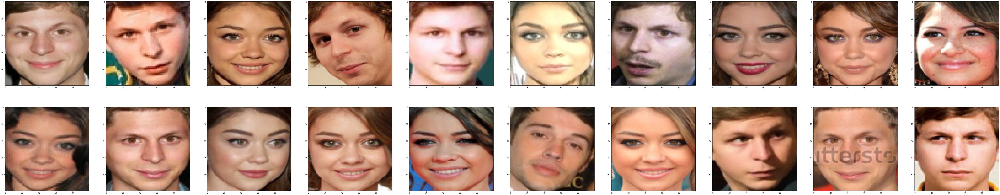

Jess


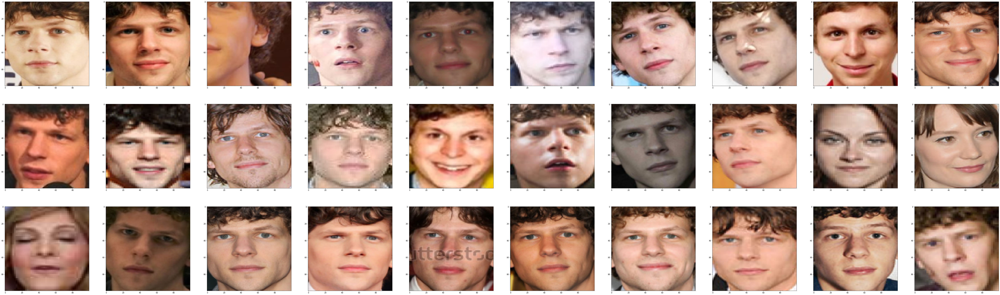

Mila


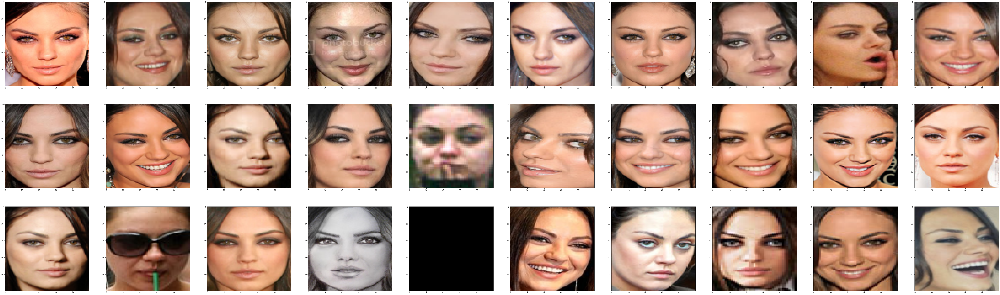

In [11]:
# preprocessed data 
preprocessor = DNNPreprocessor(path = '../../tmp', face_size = FACE_SIZE)

train_X, train_y = preprocessor(train), train['class'].values
#test_X = preprocessor(test)

#Plot Faces
print("Dopplegangers")
plot_image_sequence(train_X[train_y == 0], n=20, imgs_per_row=10)
print("Jess")
plot_image_sequence(train_X[train_y == 1], n=30, imgs_per_row=10)
print("Mila")
plot_image_sequence(train_X[train_y == 2], n=30, imgs_per_row=10)

### 0.3.4 Alternative 3: MTCNN Face Detector

Another alternative is the Multi-task Cascaded Convolutional Neural Network (MTCNN) face detector. This method combines Convolutional Neural Networks with cascades and was recently introduced by Kaipeng Zhang, et al. in 2016. It not only detects the face but also detects key points by using a cascade structure. It follow 3 stages:

1. CNN to obtain candidate windows and the strongly overlapped candidates are overlapped 
2. candidates are passed to another CNN which rejects a large number of false positives and performs calibration 
3. the facial landmark detection 

**Code MTCNN processor**

Below we provide the code for the preprocessing pipeline around the MTCNN processor.

In [12]:
# Steffi contributed to this part
class MTCNNPreprocessor():
    def __init__(self, face_size, conf_threshold = 0.95, thresholds=[0.6, 0.7, 0.7],min_face_size=30):
        self.mtcnn = MTCNN(min_face_size=min_face_size, thresholds=thresholds, image_size = np.max(face_size))
        self.face_size = face_size
        self.conf_threshold = conf_threshold

    def extract_faces(self, img):
        """Returns all faces (cropped) in an image."""
        (frameHeight, frameWidth) = img.shape[:2]
        faces = []
        boxes, probs = self.mtcnn.detect(img) #landmarks=True

        # select face with confidence larger than threshold
        if(boxes is not None):
            for box, prob in zip(boxes, probs):
                if prob > self.conf_threshold:
                    x1 = int(max(0,box[0])) #fix for avoiding clipping
                    y1 = int(max(0,box[1]))
                    x2 = int(max(0,box[2])) #TODO: fix max boundary
                    y2 = int(max(0,box[3]))
                    faces.append(cv2.resize(img[y1:y2, x1:x2], self.face_size, interpolation=cv2.INTER_AREA))

        return faces

    
    def preprocess(self, data_row):
        faces = self.extract_faces(data_row['img'])

        # if no faces were found, return None
        if len(faces) == 0 or np.isin(0 ,np.shape(faces[0])) :  # TODO :hacky fix
            nan_img = np.empty(self.face_size + (3,))
            nan_img[:] = np.nan
            return nan_img

        # only return the first face
        return cv2.resize(faces[0], self.face_size, interpolation = cv2.INTER_AREA)  
    
    def __call__(self, data):
        return np.stack([self.preprocess(row) for _, row in data.iterrows()]).astype(int)

**Visualise**

Let's plot the results (find code below) 

Dopplegangers


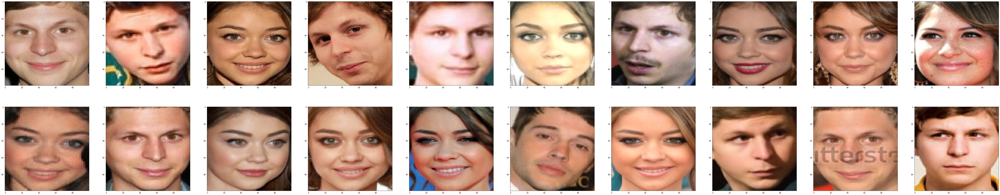

Jesse


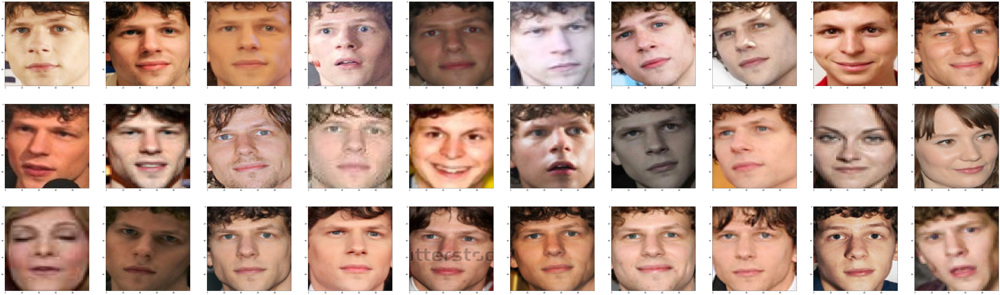

Mila


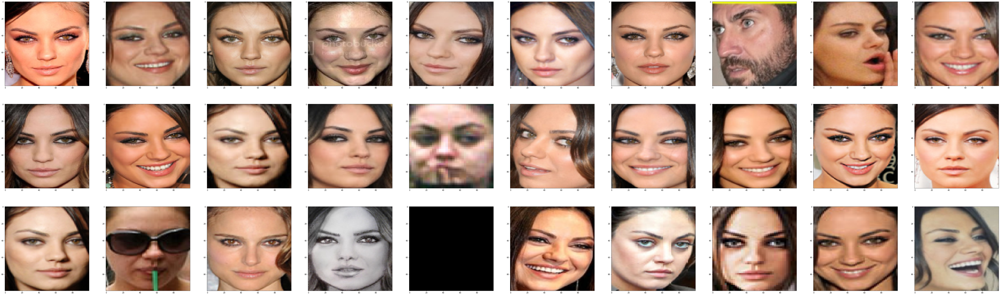

In [13]:
preprocessor = MTCNNPreprocessor(face_size = FACE_SIZE)

train_X, train_y = preprocessor(train), train['class'].values
test_X = preprocessor(test)

#Plot Faces
print("Dopplegangers")
plot_image_sequence(train_X[train_y == 0], n=20, imgs_per_row=10)
print("Jesse")
plot_image_sequence(train_X[train_y == 1], n=30, imgs_per_row=10)
print("Mila")
plot_image_sequence(train_X[train_y == 2], n=30, imgs_per_row=10)

### 0.3.5 Return all faces in one image 

Here we try not just the first detected face (simplistic method) but return all faces that are in the image. If no face is detected initially then we try again with slightly rotated image and brightness changes. 

**Code**

Below we provide the code

In [14]:
# Steffi contributed to this part
class MultiMTCNNPreprocessor():
    def __init__(self, face_size, conf_threshold = 0.95, thresholds=[0.6, 0.7, 0.7],min_face_size=30):
        self.mtcnn = MTCNN(min_face_size=min_face_size, thresholds=thresholds, image_size = np.max(face_size))
        self.face_size = face_size
        self.conf_threshold = conf_threshold

    def change_brightness(self,img, value=30):
        hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(hsv)
        v = cv2.add(v, value)
        v[v > 255] = 255
        v[v < 0] = 0
        final_hsv = cv2.merge((h, s, v))
        img = cv2.cvtColor(final_hsv, cv2.COLOR_HSV2BGR)
        return img

    def rotation(self,img, angle):
        h, w = img.shape[:2]
        M = cv2.getRotationMatrix2D((int(w / 2), int(h / 2)), angle, 1)
        img = cv2.warpAffine(img, M, (w, h))
        return img

    def extract_faces(self, img,i):
        """Returns all faces (cropped) in an image."""
        (frameHeight, frameWidth) = img.shape[:2]
        faces = []
        boxes, probs = self.mtcnn.detect(img) #landmarks=True

        # select face with largest confidence
        if(boxes is not None):
            for box, prob in zip(boxes, probs):
                if prob > self.conf_threshold:
                    x1 = int(max(0,box[0])) #fix for avoiding clipping
                    y1 = int(max(0,box[1]))
                    x2 = int(max(0,box[2])) #TODO: fix max boundary
                    y2 = int(max(0,box[3]))
                    faces.append(cv2.resize(img[y1:y2, x1:x2], self.face_size, interpolation=cv2.INTER_AREA))
        return faces

    def __call__(self, data):
        output = []
        for i, row in data.iterrows():
            faces = self.extract_faces(row['img'], i)
            if(len(faces) == 0): #Try one more time rotating
                rotImg = self.rotation(row['img'], 8)
                faces = self.extract_faces(rotImg, i)
            if (len(faces) == 0):  # Try one more time rotating
                rotImg = self.rotation(row['img'], -8)
                faces = self.extract_faces(rotImg, i)
            if(len(faces) == 0): #Try one more time rotating
                rotImg = self.rotation(row['img'], 4)
                faces = self.extract_faces(rotImg, i)
            if (len(faces) == 0):  # Try one more time rotating
                rotImg = self.rotation(row['img'], -4)
                faces = self.extract_faces(rotImg, i)
            if (len(faces) == 0):  # increase brightness
                brtImg = self.change_brightness(row['img'], 30)
                faces = self.extract_faces(brtImg, i)
            if (len(faces) == 0):  # decrease brightness
                brtImg = self.change_brightness(row['img'], -30)
                faces = self.extract_faces(brtImg, i)
            #if (len(faces) == 0):
            #    print("out of luck")
            output.append(faces)
        return output

In [15]:
# preprocessed data 
#preprocessor = MultiMTCNNPreprocessor(face_size = FACE_SIZE)

# train_X, train_y = preprocessor(train), train['class'].values
# test_X = preprocessor(test)

### 0.3.6 Select correct face in training images with multiple faces

In the case of multiple face in a single image we would like to select the correct face belonging to the object ID. It should be noted that this "pre-processing" step should actually be done in later stage when we have a face recognition model to properly classify the face - with this step we could improve the training data and thus improve the model. We do this in the following way: 

1. train the face recognition model with train images containing 1 face
2. detect all faces in the train images
3. predict the labels of all faces in the train image data and give a probability score
4. select the face that best matches the label

We would like to refer to the code of this step later in this tutorial when we have a face classification model.

In [16]:
# See after feature extrection and classifier 

### 0.3.7 Remove images from training set that do not contain a face

In this part we remove images without a face from the training data. Images without any faces are useless for training (machine learning) models to extract and learn faces - this would introduce unnecessary noise and create a negative bias. In the training data there is 1 image without a face and we remove it.

**Code**

Below we provide the code

In [17]:
#train_X, train_y = list(zip(*[(faces, train_y[idx]) for idx, faces in enumerate(train_X) if len(faces) > 0]))

### 0.3.8 Discussion of preprocessing

The data pre-processing stage is an important part of any machine learning application. For the purpose of face recognition, image data need to be standardized in a certain way and faces need to be recognized. 

We started with the HAAR face detector and tried the following face detector alternatives: DNN, CNN and MTCNN. 

We proceded to do further preprocessing by aaugment the training data by rotating the face images, extracting the face images where there are multiple faces in one image, and removing images not containing faces. We remove images not containing any faces. Images without any faces are useless for training (machine learning) models to extract and learn faces as this would introduce unnecessary noise and create a negative bias. 

This pre-processed image data can now be used for the face recognition analysis. It should be noted that appropriate pre-processing is probably the most important part for improvements. Especially in machine learning the GIGO (Garbage In, Garbage Out) principle holds and a model is only as strong as the data it gets feeded.

# 1. Feature Representations

In this section we discuss feature representations of images. We will extract features from the images to be later used in a classifier to classify the images. There are several ways in which one could extract and represent (facial) features. We will start with a naive feature extractor as the baseline case and then apply several commonly used ones such as Principal Component Analysis (PCA), Histogram of Oriented Gradients (HOG), Linear Discriminant Analysis (LDA), and Face Net. These feature extraction methods could be basically viewed as dimensionality reduction techniques where we try to reduce the high dimensional image data to lower dimensions representing certain features. We will analyze feature extractors using specialized representation plots. 

## 1.0. Example: Naive feature extractor

We will use a naive feature extractor as a baseline.

**Code**

Below we provide the code for the naive feature extractor

In [18]:
class IdentityFeatureExtractor:
    """A simple function that returns the input"""
    
    def transform(self, X):
        return X
    
    def __call__(self, X):
        return self.transform(X)

## 1.1. Baseline 1: HOG feature extractor/Scale Invariant Feature Transform

Histogram of Oriented Gradients is a feature descriptor used for object detection. A feature descriptor is a representation of an image that simplifies the image by extracting useful information from it. It primarily focuses on the structure of the object. Next to identifying if a pixel is an edge or not, HOG will also be able to provide the edge direction by extracting the gradient and orientation of the edges. All of these directions are calculated in local regions. Eventually, the feature descriptor will produce a histogram for each of localized portions in the image.

These are the necessary steps to perform HOG feature extraction:
1. Pre-process the image: resizing and colour normalization. This step is however optional.
2. Calculate the horizontal and vertical gradients, thus in both the x and y direction. 
3. Compute HOG in 8x8 cells: divide the image into many 8x8 pixel cells to make representation more compact and less sensitive to noise. In each cell, the magnitude values of these 64 cells are binned and cumulatively added into 9 buckets of unsigned direction
4. Block normalization: we slide a 2x2 cell (16x16 pixels) block across the image . Histogram values must be independent of lighting. Normalization is done on the histogram vector v within a block.
5. Calculate HOG descriptor vector, which is the concatenation of all block vectors. This vector is now used to train classifiers such as SVM and then do object detection.

**Code**

Below we provide the code for the HOG feature extractor

In [19]:
from skimage.feature import hog

class HOGFeatureExtractor(IdentityFeatureExtractor):
    
    def transform(self, X):
        features = np.zeros((X.shape[0],X.shape[1],X.shape[2]))
        i=0
        for row in X:
            img = row
            fd, hog_image = hog(img, orientations=9, pixels_per_cell=(8, 8),cells_per_block=(2, 2), visualize=True, multichannel=True)
            features[i] = hog_image
            i=i+1
        return features
    def __call__(self, X):
        features = self.transform(X)
        features = features.reshape((X.shape[0],X.shape[1]*X.shape[2]))
        return(features)

### 1.1.1. t-SNE Plots

t-SNE stands for t-distributed stochastic neighbor embedding and is a method in statistics to intuitively visualize high dimensional data based Stochastic Neighbor Embedding. t-SNE is a method of nonlinear dimensionality reduction to embed high-dimensional data into a low-dimensional space (model high dimensions to 2 or 3 dimensionsal point). It follows 2 steps: 1) t-SNE generates a probability distribution capturing distance relationships in high-dimensional space, and 2) generates low-dimensional space with similar relations between the points. t-SNE is used for visualization in various applications including computer vision and in context of this task, t-SNE is used for feature visualisation of our (HOG) extracted features.  

**Code**

Below we provide the code t-SNE plot

In [20]:
import matplotlib.patheffects as PathEffects
import seaborn as sns
from sklearn.manifold import TSNE

def fashion_scatter(x, colors):
    # choose a color palette with seaborn.
    num_classes = len(np.unique(colors))
    palette = np.array(sns.color_palette("hls", num_classes))
    
    # create a scatter plot.
    f = plt.figure(figsize=(8, 8))
    ax = plt.subplot(aspect='equal')
    sc = ax.scatter(x[:,0], x[:,1], lw=0, s=40, c=palette[colors.astype(np.int)])
    plt.xlim(-25, 25)
    plt.ylim(-25, 25)
    ax.axis('off')
    ax.axis('tight')

    # add the labels for each digit corresponding to the label
    txts = []

    for i in range(num_classes):

        # Position of each label at median of data points.

        xtext, ytext = np.median(x[colors == i, :], axis=0)
        txt = ax.text(xtext, ytext, str(i), fontsize=24)
        txt.set_path_effects([
            PathEffects.Stroke(linewidth=5, foreground="w"),
            PathEffects.Normal()])
        txts.append(txt)

    return f, ax, sc, txts


#preprocessor = MTCNNPreprocessor(face_size = FACE_SIZE)
#train_X, train_y = preprocessor(train), train['class'].values

HGO=HOGFeatureExtractor()
features = HGO.transform(train_X)

nsamples, nx, ny = features.shape
features = features.reshape((nsamples,nx*ny))
x = TSNE(random_state=123).fit_transform(features)

**Visualize**

which gives us

(<Figure size 576x576 with 1 Axes>,
 <AxesSubplot:>,
 [Text(3.6305258, -5.7181787, '0'),
  Text(-16.156178, 11.278418, '1'),
  Text(13.11198, -17.186247, '2')])

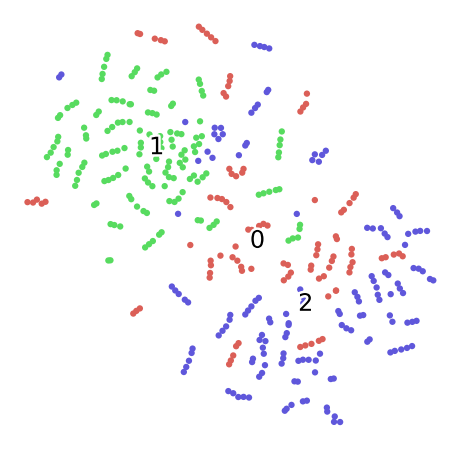

In [21]:
fashion_scatter(x, train_y)

### 1.1.2. Discussion
HOG which is a feature descriptor generates a simplified representation of the image by extracting useful information from it. The main extracted features are related to the object structure (edge, gradient, orientation…). For the purpose of understanding, t-SNE plots are used for feature visualisation of the HOG extracted features. t-SNE applies nonlinear dimensionality reduction to embed the high-dimensional feature data into a low-dimensional space. 

## 1.2. Baseline 2: PCA feature extractor

1.2 Baseline 2: PCA Feature extractor

Principle Component Analysis, one of the most commonly used unsupervised learning algorithms, is a technique used for dimensionality reduction with any number of independent features in order to obtain only the most significant features to train with. The goal is to find the vectors that best account for the distribution of face images within the entire image space. It enables identification of correlations and patterns in a dataset in order to transform it to a dataset with lower dimensions without loss of any important information. Highly correlated features, inconsistencies and redundant data will thus be removed.

The first step is the standardization of data. The data will be scaled in such a way that all the variables and their values lie within a similar, comparable range. The importance here is to make sure there is no bias in outcome because of inaccuracy. The second step is to compute the covariance matrix. It expresses the correlation between the different variables in the data set. It is essential to identify heavily dependent variables because they contain biased and redundant information that reduces the performance of the model.
The third step is to calculate eigenvectors and eigenvalues. Those are the mathematical constructs to be computed from the covariance matrix in order to determine the principle components of the data set.
The fourth step is to compute the principal components. They compress and possess most of the useful information that is scattered among all the variables. Those components are ordered in descending order according to the variance they encode. The first one will thus contain maximum information.
The last step is to reduce the dimensions of the data. The original data will be re-arranged with the final principal components, which represent the maximum and the most significant information of the data set.

**Code**

Below we provide the code

In [22]:
class PCAFeatureExtractor(IdentityFeatureExtractor):
    """TODO: this feature extractor is under construction"""
    
    def __init__(self):
        self.n_components = n_components
        self.X_train = [] #np.asarray(train_X)
        #self.X_test = []#np.asarray(test_X)
        self.h = FACE_SIZE[0]
        self.w = FACE_SIZE[1]
        self.X = np.empty((len(train_X),(self.w*self.h)))
        self.pca = PCA()
        self.pca_gray = None
        self.pca_b = None
        self.pca_g = None
        self.pca_r = None
        self.eigenfaces = np.empty((self.n_components,self.h,self.w))
        self.eigenfaces_b = np.empty((self.n_components,self.h,self.w))
        self.eigenfaces_g = np.empty((self.n_components,self.h,self.w))
        self.eigenfaces_r = np.empty((self.n_components,self.h,self.w))
    
    #Change the amount of principal components
    def set_n(self,n):
        self.n_components = n
    
    #Reshape the grayscale image data into a 2d matrix 
    def reshape_gray(self, data):
        data_new = np.empty((data.shape[0],100,100),dtype='float64')
        c = 0
        for i in range(data.shape[0]):
            d = data[i,:,:,:]
            d=d.astype(np.uint8)
            #print(data[i,:,:,:].shape)
            gray = cv2.cvtColor(d, cv2.COLOR_BGR2GRAY)
            gray = gray.astype(np.float32)
            gray = gray/255.0
            b,g,r = cv2.split(d)
            #d = d.reshape(-1, 3)
            data_new[c,:,:] = gray
            c += 1
        data = data_new
        m = len(data)
        d = self.h * self.w
        X = np.reshape(data, (m, d))
        
        return X
    
    #Reshape the image data into 3 x 2d matrix per color
    def reshape(self, data):
        data_new_b = np.empty((data.shape[0],100,100),dtype='float64')
        data_new_g = np.empty((data.shape[0],100,100),dtype='float64')
        data_new_r = np.empty((data.shape[0],100,100),dtype='float64')
        c = 0
        for i in range(data.shape[0]):
            d = data[i,:,:,:]
            d=d.astype(np.uint8)
            #print(data[i,:,:,:].shape)
            gray = cv2.cvtColor(d, cv2.COLOR_BGR2GRAY)
            
            b,g,r = cv2.split(d)
            #d = d.reshape(-1, 3)
            data_new_b[c,:,:] = b
            data_new_g[c,:,:] = g
            data_new_r[c,:,:] = r
            c += 1
        data = data_new_b
        m = len(data)
        d = self.h * self.w
        X_b = np.reshape(data, (m, d))
        
        data = data_new_g
        m = len(data)
        d = self.h * self.w
        X_g = np.reshape(data, (m, d))
        
        data = data_new_r
        m = len(data)
        d = self.h * self.w
        X_r = np.reshape(data, (m, d))
        return X_b,X_g,X_r
    
    #Apply the PCA transformation to extract the features for grayscale
    def transform_gray(self, X):
        self.X = self.reshape_gray(self.X_train)
        self.pca_gray= PCA(n_components=self.n_components, svd_solver='randomized',whiten=True).fit(self.X)
        self.eigenfaces = self.pca_gray.components_.reshape((self.n_components, self.h, self.w))
        fig = plt.figure(figsize=(16, 6))
        X_train_pca_b = self.pca_b.transform(self.X_b)
        return X_train_pca_b #, X_test_pca_b
    
    #Apply the PCA transformation to extract the features, per color channel
    def transform(self, X):
        self.X_b,self.X_g,self.X_r = self.reshape(X)
        if self.pca_b == None or self.pca_g == None or self.pca_r == None:
            self.pca = PCA(n_components=self.n_components, svd_solver='randomized',whiten=True)
            self.pca_b = self.pca.fit(self.X_b)
            self.pca_g = self.pca.fit(self.X_g)
            self.pca_r = self.pca.fit(self.X_r)
        self.eigenfaces_b = self.pca_b.components_.reshape((self.n_components, self.h, self.w))
        self.eigenfaces_g = self.pca_g.components_.reshape((self.n_components, self.h, self.w))
        self.eigenfaces_r = self.pca_r.components_.reshape((self.n_components, self.h, self.w))
        X_train_pca_b = self.pca_b.transform(self.X_b)
        X_train_pca_g = self.pca_g.transform(self.X_g)
        X_train_pca_r = self.pca_r.transform(self.X_r)
        return X_train_pca_b, X_train_pca_g, X_train_pca_r#, X_test_pca_b, X_test_pca_g, X_test_pca_r
    
    def fit(self, X_train):
        self.X_b,self.X_g,self.X_r = self.reshape(np.asarray(X_train))
        self.pca = PCA(n_components=self.n_components, svd_solver='randomized',whiten=True)
        self.pca_b = self.pca.fit(self.X_b)
        self.pca_g = self.pca.fit(self.X_g)
        self.pca_r = self.pca.fit(self.X_r)
    
    #plot the cumulative explained variance for each amount of components
    def plot_cumvar(self):
        cumsum = (self.pca_b.explained_variance_ratio_.cumsum()+self.pca_g.explained_variance_ratio_.cumsum()+self.pca_r.explained_variance_ratio_.cumsum())/3.0
        plt.plot(cumsum,lw=3)
        ind = np.argwhere(cumsum > 0.95)
        plt.show()
        return ind[0]
    
    #Show the reconstruction of a grayscale face using eigenfaces 
    def plot_eigenfaces_increment_gray(self):
        im_c = self.X[0]
        im = im_c.astype(np.uint8)
        im = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
        im = im/255.0
        mean_b = self.pca_b.mean_
        imVector_b = im.flatten() - mean_b
        output_b = mean_b.reshape(self.h,self.w)
        outputs = np.empty((len(self.X), 100, 100))
        for i in range(0,len(self.X)):
            for j in range(0,i):
                weight_b = np.dot(imVector_b, self.pca_b.components_[i])
                output_b = output_b + self.eigenfaces_b[i] * weight_b
            normalizedImg = np.empty_like(output_b)
            normalizedImg = cv2.normalize(output_b,  normalizedImg, 0, 255, cv2.NORM_MINMAX)
            outputs[i] = normalizedImg
        plot_image_sequence(outputs, n=len(self.X), imgs_per_row=10)
    
    #Show the reconstruction of a color face using eigenfaces 
    def plot_eigenfaces_increment(self):
        im_c = self.X[0]
        im = im_c.astype(np.uint8)
        #im = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
        plt.imshow(im) 
        b,g,r = cv2.split(im)
        mean_b = self.pca_b.mean_
        mean_g = self.pca_g.mean_
        mean_r = self.pca_r.mean_
        imVector_b = b.flatten() - mean_b
        imVector_g = g.flatten() - mean_g
        imVector_r = r.flatten() - mean_r
        output_b = mean_b.reshape(self.h,self.w)
        output_g = mean_g.reshape(self.h,self.w)
        output_r = mean_r.reshape(self.h,self.w)
        outputs = np.empty((self.n_components, 100, 100, 3))
        for i in range(0,self.n_components):
            for j in range(0,i):
                weight_b = np.dot(imVector_b, self.pca_b.components_[i])
                weight_g = np.dot(imVector_g, self.pca_g.components_[i])
                weight_r = np.dot(imVector_r, self.pca_r.components_[i])
                output_b = output_b + self.eigenfaces_b[i] * weight_b
                output_g = output_g + self.eigenfaces_g[i] * weight_g
                output_r = output_r + self.eigenfaces_r[i] * weight_r
            normalizedImg_b = np.empty_like(output_b, dtype=np.uint8)   
            normalizedImg_g = np.empty_like(output_b, dtype=np.uint8)  
            normalizedImg_r = np.empty_like(output_b, dtype=np.uint8) 
            
            normalizedImg_b = cv2.normalize(output_b,  normalizedImg_b, 0, 1, cv2.NORM_MINMAX)
            normalizedImg_g = cv2.normalize(output_g,  normalizedImg_g, 0, 1, cv2.NORM_MINMAX)
            normalizedImg_r = cv2.normalize(output_r,  normalizedImg_r, 0, 1, cv2.NORM_MINMAX)
            outputs[i] = cv2.merge((normalizedImg_b, normalizedImg_g, normalizedImg_r))
        plot_image_sequence(outputs, n=self.n_components, imgs_per_row=10)
    
    def inverse_transform_gray(self, X):
        Y = self.pca_gray.inverse_transform(X)
        return Y
    def inverse_transform_b(self, X):
        Y = self.pca_b.inverse_transform(X)
        return Y
    def inverse_transform_g(self, X):
        Y = self.pca_g.inverse_transform(X)
        return Y
    def inverse_transform_r(self, X):
        Y = self.pca_r.inverse_transform(X)
        return Y
    def __call__(self, X):
        self.X = np.asarray(X)
        X_pca_b, X_pca_g, X_pca_r = self.transform(X) #, X_test_pca_b, X_test_pca_g, X_test_pca_r = 
        X_pca = X_pca_b + X_pca_g + X_pca_r
        return X_pca

Now we apply the code to generate features. Firstly we need to find the minimum amount of features to keep as much information as possible (95%). When this number is found we rerun the pca transformation to retain the ideal amount of components.

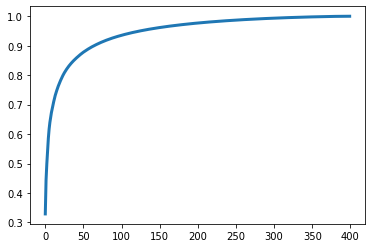

to retain 95% of information, at least 124 principal components are needed


In [23]:
n_components = min(len(train_X), FACE_SIZE[0]*FACE_SIZE[1])
fe_pca = PCAFeatureExtractor()
X_train_pca = fe_pca(train_X)
X_test_pca = fe_pca(test_X)
ind = fe_pca.plot_cumvar()
print(f'to retain 95% of information, at least {ind[0]} principal components are needed')
n_components = ind[0]
fe_pca.set_n(n_components)
fe_pca.fit(train_X)
X_train_pca = fe_pca(train_X)
X_test_pca = fe_pca(test_X)

### 1.2.1. Eigenface Plots

Eigenfaces are based PCA to characterize features within the image data that capture the variation between images. Every images is thus characterize as a linear combination of features (eigenfaces). Eigenfaces are recontructed images from the eigenvector space (which consists of vectors associated with a linear system of equations). Every image has a different projection of the eigenvector space. The following steps are used:
1. compute eigenfaces from data, keeping those with the higher eigenvalues.
2. projecting images on eigenspace
3. Compute weights of new image using the eigenspace.

**Code**

**Visualization**

Original code is found in the 'PCAFeatureExtractor' class

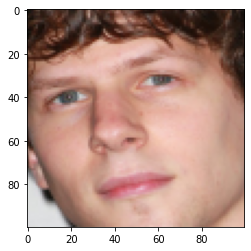

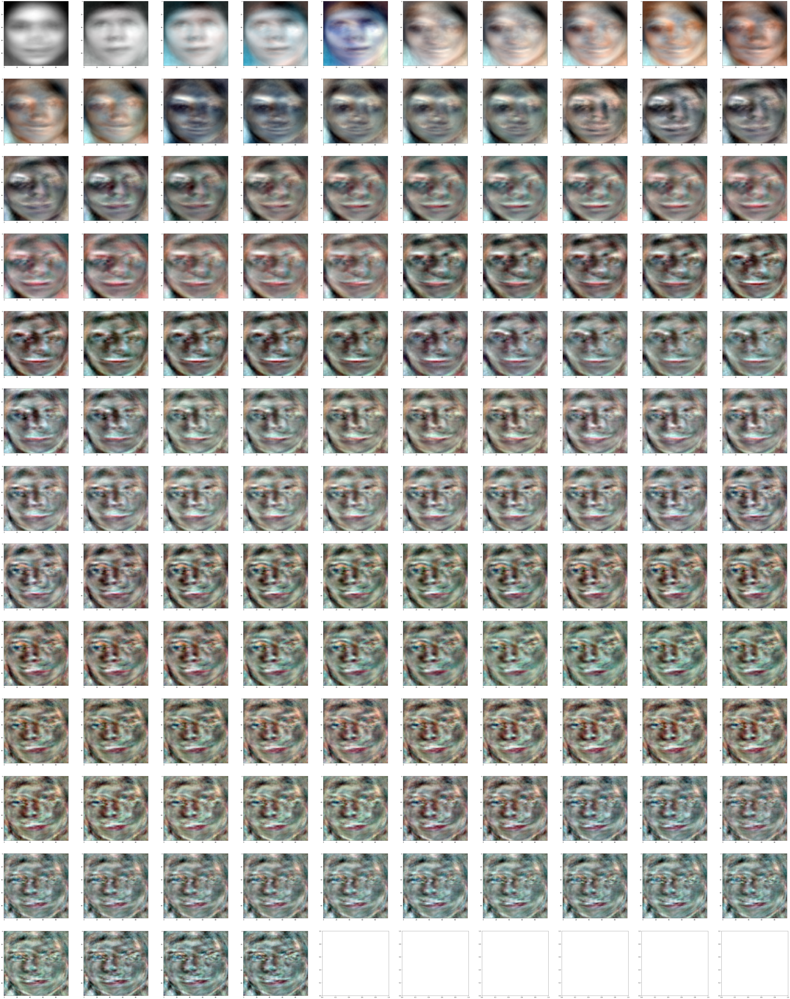

In [24]:
fe_pca.plot_eigenfaces_increment()

### 1.2.2. Feature Space Plots

Feature space can be used to check portioning where a feature space is a scatter plot of the pixel values of two bands. The intensity of the feature space image is the number of pixels in the image with certain brightness. The more intense the color, the higher the density of pixels with that particular combination of brightnesses. 

**Code**

Below we provide the code

In [25]:
def plot_featurespace(feature_set, images):
    fig, ax = plt.subplots(figsize=(20,16))
    ax.scatter(feature_set[:,0],feature_set[:,1]) 
    for x0, y0, image in zip(feature_set[:,0],feature_set[:,1],images):
        img = image.astype(np.uint8)
        #img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        img = cv2.resize(img,(40,40))
        img = OffsetImage(img)
        ab = AnnotationBbox(img, (x0, y0), frameon=False)
        ax.add_artist(ab)
        ax.set_xlabel('Principal component 1')
        ax.set_ylabel('Principal component 2')
        ax.set_title('Projection of images on 2d eigenspace')
    plt.show()

**Visualization**<br>
First the training set, then the test set

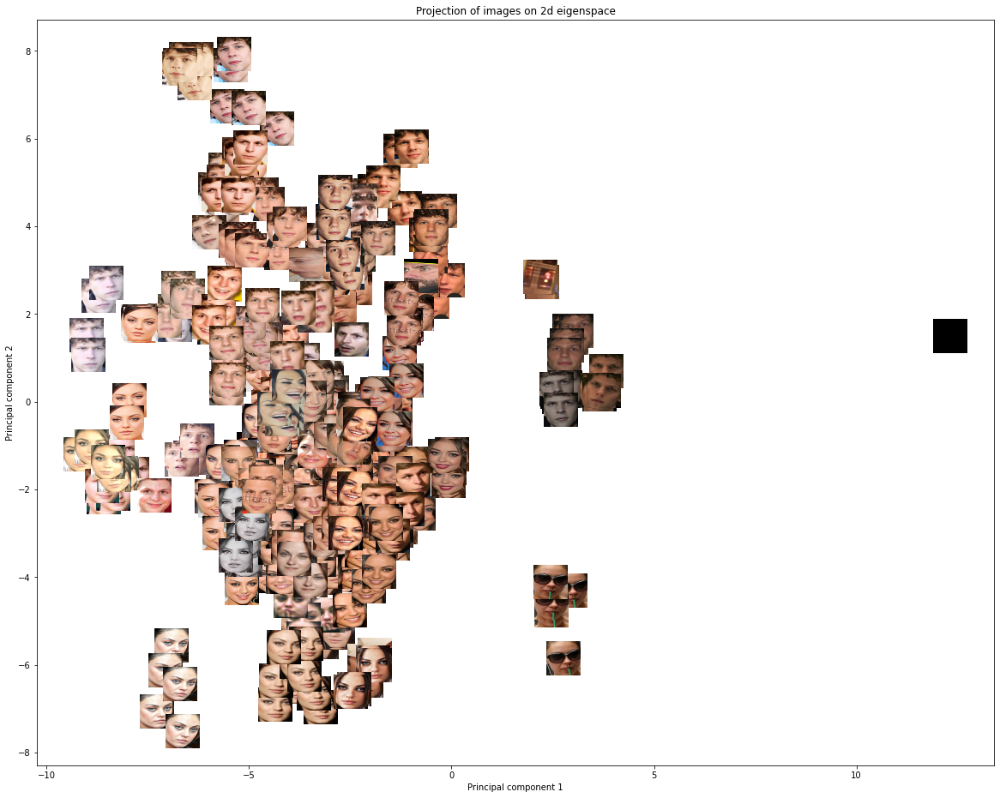

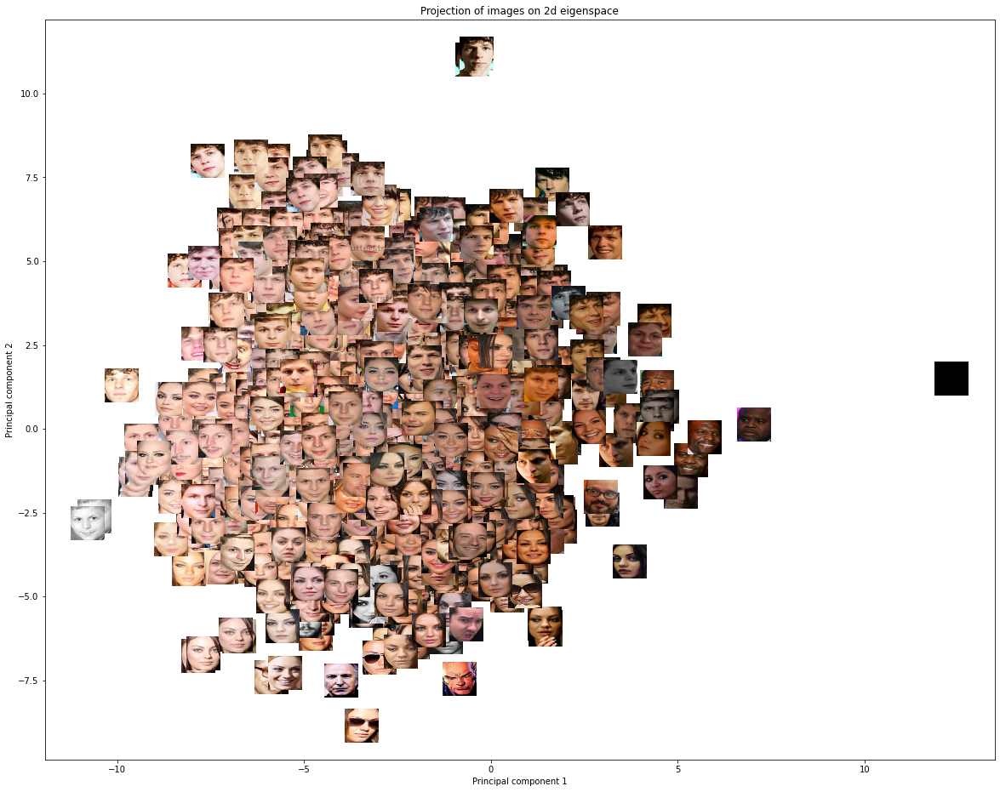

In [26]:
plot_featurespace(X_train_pca,train_X)
plot_featurespace(X_test_pca, test_X)

### 1.2.3. Discussion
PCA is a commonly used technique for linear dimensionality reduction (it should be noted that there are also non-linear PCA measures but for the purpose of this tutorial we will stick to the linear PCA). Here we try to find vectors that best account for the distribution of face images within the image space and the image data to a lower dimensional space without significant loss of information. We will use eigenface and feature space plots to analyze the results. Eigenfaces are based PCA to characterize features within the image data and are recontructed images from the eigenvector space (which consists of vectors associated with a linear system of equations). Feature space can be used to check portioning where a feature space is a scatter plot of the pixel values of two bands. The intensity of the feature space image is the number of pixels in the image with certain brightness. The more intense the color, the higher the density of pixels with that particular combination of brightnesses. From the eigenface plots we can see the variations of an image based on the features within the data constructed from the (linear) eigenvector space. From the same image several variations can be constructed this way and these are visualized accordingly above. The feature space plots portion the images according to intensity (brightness). It is clear that the pictures can be pretty well classified based on the intensity and thus useful features can be extracted. 

## 1.3. Improvement 1: LDA feature extractor

Linear discriminant analysis is similar to the PCA technique, but it is a supervised learning technique. The goal is to project a dataset onto a lower-dimensional space with good class separability to avoid overfitting and to reduce computational costs. While on PCA we calculate components to find axes on which data is projected such that variance is maximized. In LDA however, we find axes such that the class-separation is maximized. 
PCA will attempt to maintain data information and LDA will make the data points more distinguishable after dimension reduction. LDA thus takes labelling into account. Mathematically, we compute the between-class matrix and the within-class matrix. The eigenvalues are retrieved from those 2 matrices. PCA will attempt to maintain data information and LDA will make the data points more distinguishable after dimension reduction.

These are the 5 general steps to perform LDA:
1. Compute the dimensional mean vectors for the different classes from the dataset.
2. Compute the scatter matrices.
3. Compute the eigenvectors and corresponding eigenvalues from these scatter matrices.
4. Sort the eigenvectors in a descending order according to eigenvalues and choose the largest K eigenvectors to form a d.K-dimensional matrix. 
5. Use this matrix to transform the samples onto the new subspace. 

**Code**

Below we provide the code

In [27]:
#Could be seen as feature extractor (2 feature values per image), and classifier (lda.predict))
class LDA(IdentityFeatureExtractor):
    def __init__(self, X_train_pca, X_test_pca, train_y, pca_feature_extractor):
        self.train_y_tot = train_y
        self.X_train_pca = X_train_pca
        self.X_test_pca = X_test_pca
        self.lda = LinearDiscriminantAnalysis()
        self.lda_b = LinearDiscriminantAnalysis()
        self.lda_g = LinearDiscriminantAnalysis()
        self.lda_r = LinearDiscriminantAnalysis()
        self.X_train, self.X_valid, self.y_train, self.y_valid = train_test_split(X_train_pca, train_y,
                                                            test_size=0.25,
                                                            random_state=42)
        self.fe_pca = pca_feature_extractor
        self.ldatrA = np.empty((len(self.X_train),2))
        self.ldatvA = np.empty((len(self.X_valid),2))
        self.ldatsA = np.empty((len(self.X_test_pca),2))
        
    def transform(self):
        self.lda.fit(self.X_train, np.asarray(self.y_train))
        self.ldatrA = self.lda.transform(self.X_train)
        self.ldatvA = self.lda.transform(self.X_valid)
        self.ldatsA = self.lda.transform(self.X_test_pca)
        return self.ldatrA,self.ldatvA,self.ldatsA

    #Use cross validation to check performance
    def check_performance(self):
        yHat = self.lda.predict(self.X_valid)
        outVal_acc = accuracy_score(self.y_valid, yHat)
        outVal_prec = precision_score(self.y_valid, yHat,average='weighted')
        outVal_rec = recall_score(self.y_valid, yHat,average='weighted')
        outVal_f1 = f1_score(self.y_valid, yHat,average='weighted')
        print('Accuracy score: ' + str(outVal_acc))
        print('Precision score: ' + str(outVal_prec))
        print('Recall score: ' + str(outVal_rec))
        print('F1 score: ' + str(outVal_f1))
    
    def plot_featurespace(self):
        colors = ['red','green','blue']
        plt.figure()
        plt.scatter(self.ldatrA[:,0], self.ldatrA[:,1], c=self.y_train, cmap=matplotlib.colors.ListedColormap(colors))
        plt.title('All training faces distributed according to 2 LDA features, each color is a different label')
        plt.show()
        plt.figure()
        plt.scatter(self.ldatvA[:,0], self.ldatvA[:,1], c=self.y_valid, cmap=matplotlib.colors.ListedColormap(colors))
        plt.title(('All validation faces distributed according to 2 LDA features, each color is a different label'))
        plt.show()

    def show_fisherfaces(self, X_train_pca_b,X_train_pca_g,X_train_pca_r):
        self.lda_b.fit(X_train_pca_b, np.asarray(self.train_y_tot))
        self.lda_g.fit(X_train_pca_g, np.asarray(self.train_y_tot))
        self.lda_r.fit(X_train_pca_r, np.asarray(self.train_y_tot))
        plt.figure(figsize=(20,20))
        for i in range(2):
            #Map from PCA space back to the original space (of images)
            C1 = self.fe_pca.inverse_transform_b(self.lda_b.scalings_[:, i])
            C1.shape = [100, 100]
            C2 = self.fe_pca.inverse_transform_g(self.lda_g.scalings_[:, i])
            C2.shape = [100, 100]
            C3 = self.fe_pca.inverse_transform_r(self.lda_r.scalings_[:, i])
            C3.shape = [100, 100]
            C = np.dstack((C1,C2,C3))
            C_w = np.empty_like(C)
            cv2.normalize(C,  C_w, 0, 1, cv2.NORM_MINMAX)
            ax = plt.subplot(1, 2, i + 1)
            ax.imshow(C_w)
        plt.show()

In [28]:
fe_lda = LDA(X_train_pca, X_test_pca, train_y, fe_pca)
X_train_lda, X_valid_lda, X_test_lda = fe_lda.transform()

### 1.3.1. Performance

We use a variety of evaluation measures and cross-validation to check the performance. More specifically we check accuracy, precision, recall & f1 which are some of the most used measures. 

**Code**

Below we provide the code

In [29]:
fe_lda.check_performance()

Accuracy score: 0.92
Precision score: 0.9241666666666666
Recall score: 0.92
F1 score: 0.9208421052631579


### 1.3.2. Plot samples in featurespace

Similar as with PCA (cfr above), we can again construct a feature space. For the discussion of feature space we would like to refer to the discussion above. 

**Visualize**

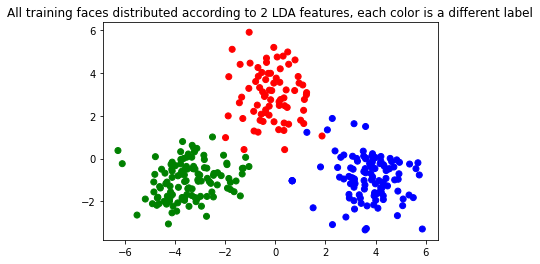

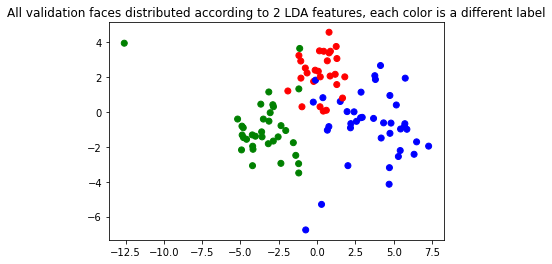

In [30]:
fe_lda.plot_featurespace()

### 1.3.3. Show fisherfaces

FisherFaces is an improvement of the EigenFaces method and uses a combination of PCA and LDA. Fisherfaces algorithm extracts principle components that separates one individual from another. Image recognition using this algorithm is based on reduction of face space domentions using PCA method and then applying LDA method also known as Fisher Linear Discriminant (FDL) method to obtain characteristic features of image. LDA is used to find a linear combination of features that separates two or more classes or objects. It can be used for dimension reduction before further classification. It attempts to model the difference between classes of data.

For people interested we would like to refer to the following paper on Fisher faces of Belhumeur, Hespanha, and Kriegman (1997): 
https://cseweb.ucsd.edu/classes/wi14/cse152-a/fisherface-pami97.pdf 


**Visualize**

which gives us

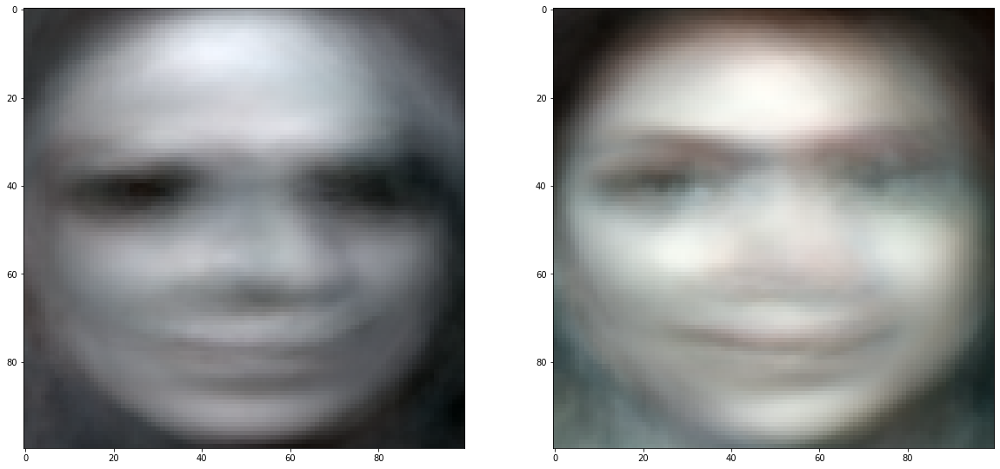

In [31]:
X_train_pca_b,X_train_pca_g,X_train_pca_r = fe_pca.transform(train_X)
fe_lda.show_fisherfaces(X_train_pca_b,X_train_pca_g,X_train_pca_r)


LDA is a supervised dimensionality reduction technique used to project the data onto a lower-dimensional space with good class separability. In LDA the class-separation is maximized and LDA will make the data points more distinguishable after dimension reduction. We can here again visualize the results using a feature space plot. Furthermore, we could use a fisherface plot. FisherFaces are an improvement of the EigenFaces method and uses a combination of PCA and LDA. Fisherfaces algorithm extracts principle components that separates one individual from another. Image recognition using this algorithm is based on reduction of face space domentions using PCA method and then applying LDA method also known as Fisher Linear Discriminant (FDL) method to obtain characteristic features of image. LDA is used to find a linear combination of features that separates two or more classes or objects. It can be used for dimension reduction before further classification. It attempts to model the difference between classes of data. We find that LDA has strong performance in terms of accuracy, precision, recall and F1 with all close to 0.9. When plotting the feature space we can see that the pictures can be pretty well classified based on the intensity and thus useful features can be extracted. When plotting the FisherFace we can see how the images of 2 individuals are separated. 

## 1.5. Improvement 3: FaceNet feature extractor

This approach is based on producing an embedding from a face, described in the famous paper “FaceNet: A Unified Embedding for Face Recognition and Clustering” by Florian Schroff, et al. at Google. It is a system that, given a picture of a face, will extract high-quality features from the face and predict a 128 element (128 bytes per face) vector representation of these features, which is called a face embedding. The model consists of a deep convolutional neural network that is based on a triplet loss function, which directly optimizes the embedding itself. This loss function minimizes the distance between a positive (the same person) and an anchor (the benchmark) while maximizing the distance between the anchor and a negative (not the same person).

It is a robust, unified and effective face recognition system used for verification (whether these two faces are the same person), face recognition (to predict who this person is) and clustering (finding common people among faces).

In our approach, we based ourselves on the prominent project by David Sandberg that provides FaceNet models built and trained using TensorFlow. The implemented architecture here is Inception ResNet v1.

The pre-trained model is based on the VGGFace2 dataset, which is a large-scale face recognition dataset. Images are downloaded from Google and consist of variations in angle, age, lighting, ethnicity and profession. Face distribution for different identities is varied, from 87 to 843, with an average of 362 images for each subject. 

The following paper of Schroff, Kalenichenko and Philbin (2015) is an excellent discussion on FaceNet for the students interested: https://arxiv.org/abs/1503.03832

**Code**

Below we provide the code

In [32]:
# Steffi contributed to this part
class MultiFaceNetFeatureExtractor():
    def __init__(self):
        self.model = InceptionResnetV1(pretrained='vggface2').eval()

    def fixed_image_standardization(self,image_tensor):
        processed_tensor = (image_tensor - 127.5) / 128.0
        return processed_tensor

    def transform(self, img):
        return self.fixed_image_standardization(F.to_tensor(np.float32(img))) #.unsqueeze(0)

    def __call__(self, imgFaceList):
        featuresList = []
        for faces in imgFaceList:
            if(len(faces) > 0):
                inputTensor = torch.stack([self.transform(face) for face in faces])
                featuresList.append(self.model(inputTensor).detach().numpy())
            else:
                featuresList.append([])
        return featuresList


### 1.5.1 Discussion

For the discussion of the results of the FaceNet classifier we would like to refer to the experiment section of this tutorial. 

## 1.6. Discussion

In face recognition, the image first prepared for preprocessing and then trained the face recogniser to recognise the faces. We have used feature spaces, eigenfaces, fisher faces...

https://cseweb.ucsd.edu/classes/wi14/cse152-a/fisherface-pami97.pdf

https://ieeexplore.ieee.org/document/598228

There are several ways in which one could extract and represent (facial) features. We have started with a naive feature extractor as the baseline case and then applied several commonly used ones such as Principal Component Analysis (PCA), Histogram of Oriented Gradients (HOG), and Linear Discriminant Analysis (LDA). Finally we have applied the more advanced method of FaceNet. These feature extraction methods could be basically viewed as dimensionality reduction techniques where we try to reduce the high dimensional image data to lower dimensions representing certain features. We found that each of the feature extractors seems to do a pretty good job on the task at hand. 

# 2. Evaluation Metrics

We use a variety of evaluation measures and cross-validation to check the performance. More specifically we check accuracy, precision, recall & F1 which are some of the most used measures. 

Accuracy is the proportion of correct predictions over the total amount of predictions. this is probably the mostly used basic and intuitive evaluation measure in classification. ne may think that, if we have high accuracy then our model is best. It should be noted that accuracy is a good measure when the data is symmetric (i.e. amount of false positive and false negatives are similar). Precision is the ratio of correctly predicted positive observations to the total predicted positive observations. High precision relates to the low false positive rate. Recall or sensitivity is the ratio of correctly predicted observations relative to the observations in the class. F1 is the weighted average of precision and recall so it applies both false positives and false negatives (F1 Score = 2*(Recall * Precision) / (Recall + Precision)). F1 is mainly useful in the case of asymmetric data and class distribution (while accuracy works in the case of symmetry) If the cost of false positives and false negatives is assymetric, it’s better to look at both Precision and Recall (i.e. F1). 

Here we provide a function that prints out values for different evaluation measures. These are used in the evaluation of the experiments later in this tutorial. 

In [33]:
def check_performance(yHat, y_true):
    outVal_acc = accuracy_score(y_true, yHat)
    outVal_prec = precision_score(y_true, yHat,average='weighted')
    outVal_rec = recall_score(y_true, yHat,average='weighted')
    outVal_f1 = f1_score(y_true, yHat,average='weighted')
    print('Accuracy score: ' + str(outVal_acc))
    print('Precision score: ' + str(outVal_prec))
    print('Recall score: ' + str(outVal_rec))
    print('F1 score: ' + str(outVal_f1))
    return outVal_acc, outVal_prec, outVal_rec,outVal_f1

# 3. Classifiers

Finally we use classifier models to recognize/detect images and classify them according to the appropriate label. 

We start this exercise with a naive random classifier. Then we proceed with two popular classifiers in face recognition, namely, the K-nearest neighbors (KNN) algorithm and the Support Vector Machine (SVM) model. Finally we compare the classifiers and select the best one for the purpose of this face recognition exercise.

## 3.0. Random classifier

This random classifier is not very complicated. It makes predictions at random, based on the distribution obseved in the training set. **It thus assumes** that the class labels of the test set will be distributed similarly to the training set.

**Code Random Classifier**

Below we provide code for the pipeline of the random classifier

In [34]:
class RandomClassificationModel:
    """Random classifier, draws a random sample based on class distribution observed 
    during training."""
    
    def fit(self, X, y):
        """Adjusts the class ratio instance variable to the one observed in y. 

        Parameters
        ----------
        X : tensor
            Training set
        y : array
            Training set labels

        Returns
        -------
        self : RandomClassificationModel
        """
        
        self.classes, self.class_ratio = np.unique(y, return_counts=True)
        self.class_ratio = self.class_ratio / self.class_ratio.sum()
        return self
        
    def predict(self, X):
        """Samples labels for the input data. 

        Parameters
        ----------
        X : tensor
            dataset
            
        Returns
        -------
        y_star : array
            'Predicted' labels
        """

        np.random.seed(0)
        return np.random.choice(self.classes, size = X.shape[0], p=self.class_ratio)
    
    def __call__(self, X):
        return self.predict(X)
    

Let’s move on to classifiers that actually learn something. 

## 3.1: KNN

The K-Nearest Neighbour, a supervised learning algorithm, is one of the simpler classifiers out there but tends to be quite effective. The idea is that the algorithm classifies unknown data points by finding the closest match of the test data in feature space. Those ‘k-closest examples’ are considered as a vote and the class with the most of these votes wins. 

To use this procedure, Euclidian distance or the Manhattan distance is commonly chosen as a distance metric.

General steps that are used:
1. Data points with defined labels will be clustered using, in our case, PCA.
2. A data point with unknown label will be added to the plot.
3. This data point will be classified by looking at the nearest annotated data points. If K = 1, we only use the nearest neighbour to define the class. If K > 1, the class will be picked that gets the most votes. In our case we used the default value of K, which is 5. 

There is no perfect way to determine the ‘best’ value for K. We only know that low values of K (K = 1 or K = 2) can be noisy and affected by outliers. Changing the value of K will not significantly change our results in the classification that we are doing, so we kept it at 5. 

**Code KNN Classifier**

Below we provide code for the pipeline of the SVM classifier

In [35]:
class kNNClassificationModel(RandomClassificationModel):
    def __init__(self):
        self.feature_set = []
        self.bestmodel = KNeighborsClassifier()
        self.lastModel = KNeighborsClassifier()
        self.train_y = []
        self.bestscaler = Normalizer()
        self.lastscaler = Normalizer()
        self.train_prec = []
        self.test_prec = []
        self.train_rec = []
        self.test_rec = []
        self.train_f1 = []
        self.test_f1 = []
        self.train_acc = []
        self.test_acc = []
        self.ind = 0
        
    def fit(self,feature_set, y_set):
        self.feature_set = feature_set
        self.train_y = y_set
        knns = []
        scalers = []
        for i in range(len(self.feature_set[0])):
            X_knn = self.feature_set[:,0:i+1]
            X_train_knn, X_test_knn, y_train_knn, y_test_knn = train_test_split(X_knn, self.train_y,test_size=0.25,random_state=42)
            scaler = Normalizer()
            X_train_knn = scaler.fit_transform(X_train_knn)
            X_test_knn = scaler.transform(X_test_knn)
            scalers.append(scaler)
            # Fit k-NN classifier and make predictions
            knn = KNeighborsClassifier()
            knn.fit(X_train_knn, y_train_knn)
            y_pred_train = knn.predict(X_train_knn)
            y_pred_test = knn.predict(X_test_knn)
            self.train_prec.append(precision_score(y_train_knn, y_pred_train,average='weighted'))
            self.test_prec.append(precision_score(y_test_knn, y_pred_test,average='weighted'))
            self.train_rec.append(recall_score(y_train_knn, y_pred_train, average='weighted'))
            self.test_rec.append(recall_score(y_test_knn, y_pred_test, average='weighted'))
            self.train_f1.append(f1_score(y_train_knn, y_pred_train, average='weighted'))
            self.test_f1.append(f1_score(y_test_knn, y_pred_test, average='weighted'))
            self.train_acc.append(accuracy_score(y_train_knn, y_pred_train))
            self.test_acc.append(accuracy_score(y_test_knn, y_pred_test))
            knns.append(knn)
        self.ind = np.argmax(self.test_f1)
        print(f'Ideal number of dimensions for this feature set is {self.ind}')
        self.bestmodel = knns[self.ind]
        self.bestscaler = scalers[self.ind]
        self.lastmodel = knns[-1]
        self.lastscaler = scalers[-1]
        return knns, scalers, self.bestmodel,self.bestscaler, self.ind
    
    def plot_scores(self):
        # Plot accuracy by n_neighbors
        plt.figure(figsize=(8, 6))
        plt.plot(range(1,len(self.feature_set[0])+1), self.train_prec, label='Train precision Score')
        plt.plot(range(1,len(self.feature_set[0])+1), self.test_prec, label='Test precision Score')
        plt.ylabel('precision Score')
        plt.xlabel('# of Principal Components')
        plt.legend()
        plt.show()
        plt.figure(figsize=(8, 6))
        plt.plot(range(1,len(self.feature_set[0])+1), self.train_rec, label='Train recall Score')
        plt.plot(range(1,len(self.feature_set[0])+1), self.test_rec, label='Test recall Score')
        plt.ylabel('recall Score')
        plt.xlabel('# of Principal Components')
        plt.legend()
        plt.show()
        plt.figure(figsize=(8, 6))
        plt.plot(range(1,len(self.feature_set[0])+1), self.train_f1, label='Train f1 Score')
        plt.plot(range(1,len(self.feature_set[0])+1), self.test_f1, label='Test f1 Score')
        plt.ylabel('f1 Score')
        plt.xlabel('# of Principal Components')
        plt.legend()
        plt.show()
        plt.figure(figsize=(8, 6))
        plt.plot(range(1,len(self.feature_set[0])+1), self.train_acc, label='Train accuracy Score')
        plt.plot(range(1,len(self.feature_set[0])+1), self.test_acc, label='Test accuracy Score')
        plt.ylabel('accuracy Score')
        plt.xlabel('# of Principal Components')
        plt.legend()
        plt.show()
        
    def predict(self, image, image_pca):
        plt.imshow(image)
        image_trans = self.bestscaler.transform(image_pca.reshape(1,-1))
        pred = self.bestmodel.predict(image_trans)
        if pred == 0:
            print('Michael or Sarah')
        elif pred == 1:
            print('Jesse')
        else:
            print('Mila')
    
    def test(self, test_set_pca, test_set_ims, n_images, knn,scaler):
        samples_pca = []
        samples_ims = []
        show_ims=[]
        for i in range(n_images):
            id = np.random.choice(np.arange(len(test_set_pca)), replace=False)
            samples_pca.append(test_set_pca[id])
            samples_ims.append(test_set_ims[id])
        test_trans = scaler.transform(samples_pca)
        pred = knn.predict(test_trans)
        for i in range(len(pred)):
            if pred[i] == 0:
                text = 'Michael or Sarah'
            elif pred[i] == 1:
                text = 'Jesse'
            else:
                text = 'Mila'
            image = samples_ims[i]
            image = image/255.0
            font = cv2.FONT_HERSHEY_SIMPLEX
            org = (10, 90)
            fontScale = 0.28
            color = (255, 255, 255)
            thickness = 1
            cv2.putText(image, text, org, font, fontScale, 
                     color, thickness, cv2.LINE_AA)
            show_ims.append(image)
        plot_image_sequence(show_ims, n=n_images, imgs_per_row=5)

    def __call__(self,feature_set, bestmodel = False):
        if not bestmodel:
            fs_trans = self.lastscaler.transform(feature_set)
            y = self.lastmodel.predict(fs_trans)
            return y
        else:
            print(len(feature_set[:self.ind+1]))
            fs_trans = self.bestscaler.transform(feature_set[:self.ind+1])
            y = self.bestmodel.predict(fs_trans)
            return y
    


Ideal number of dimensions for this feature set is 90


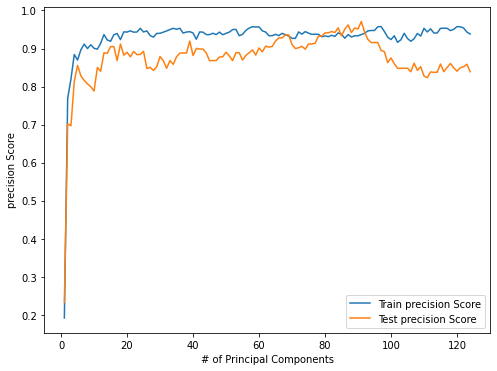

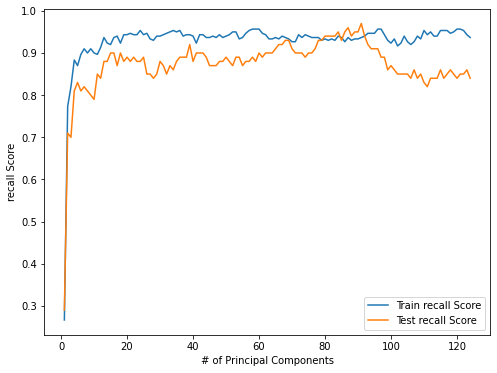

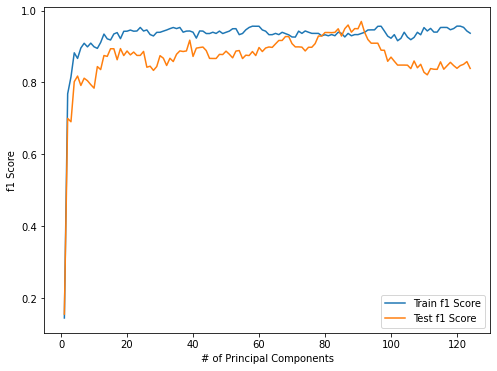

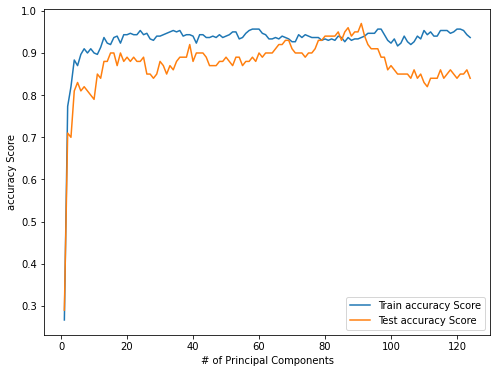

In [36]:
knn = kNNClassificationModel()
knns, scalers, bestknn, bestscaler, ind = knn.fit(X_train_pca, train_y)
knn.plot_scores()

Here are some examples of predictions by our knn-model:

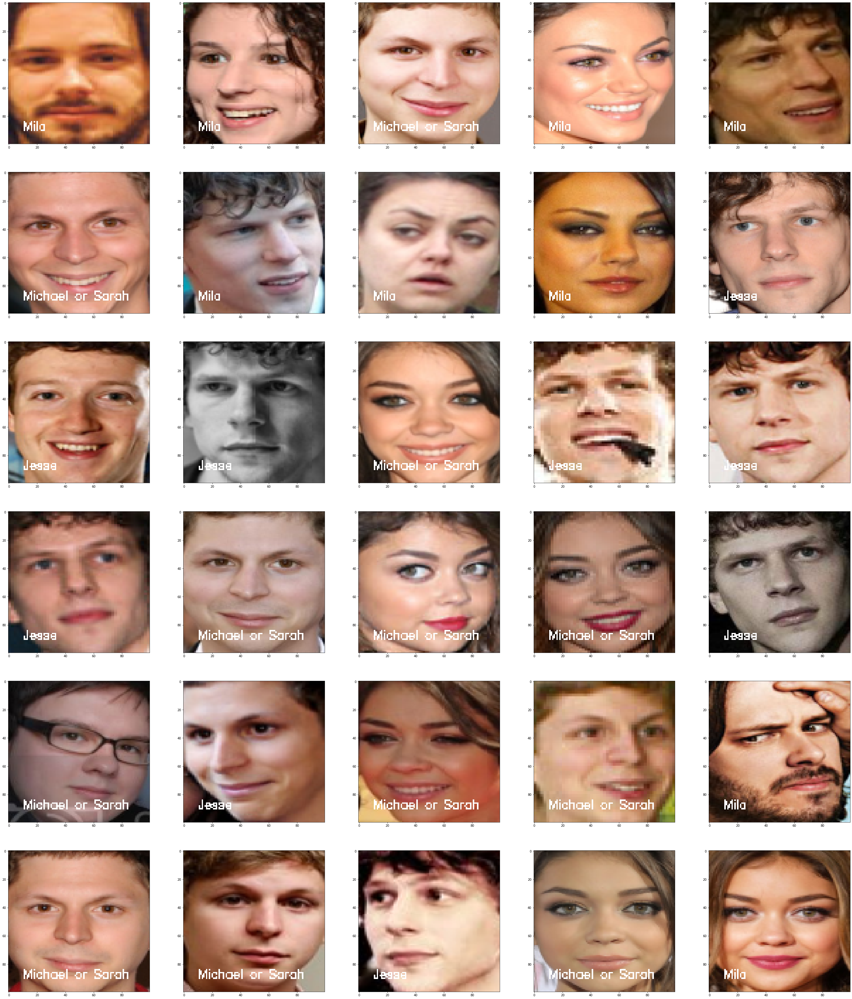

In [37]:
knn.test(X_test_pca[:,:ind+1],test_X,30,bestknn,bestscaler)

## 3.2: SVM

Support Vector Machines (SVMs) are a popular classifier within the face recognition literature. Support vector machines is a classifier that has the goal of creating linear decision boundaries to classify multiple classes. SVM is a supervised learning algorithm that creates a hyperplane to separate classes. It maximizes separation boundaries between data points depending on the given classes in an n-dimensional space. In this context, support vectors are the data points with the minimum distance to this hyperplane. In the SVM classifier, a kernel is implemented that transforms the input data space to the right form. This way, it is possible to convert a non-separable space to a separable space.

The regular SVM algorithm does not support multiple classification, but only binary classification. However, the SVM we use is an extension that can handle multiple faces and is adapted to be able to build a classifier model with images with only one face. The reasoning here is that the mapping of data points occurs on high dimensional space to obtain mutual linear separation between every two categories.

This SVM can handle multiple faces and is adapted to be able to build a classifier model with images with only one face.

For the students interested, we provide links to the referenced papers:

https://ieeexplore.ieee.org/abstract/document/5276938?casa_token=W8UR_KpJm_4AAAAA:eQ6wfumEtwshN4-TYWnV5uFfIOrSfVEXZihnJ2GE7n7lKcF5lQg7wwgvb8cPvW-qHG3PXm58Ig

https://www.sciencedirect.com/science/article/pii/S0957417410001181?casa_token=cmbD3YqXIvkAAAAA:HS7KQgxafVjL75afN-u8hagJFucaIesJkPgLov7dxpCpcDeXLc_FH-pBqivSzRuReHDP5soBPhk

https://www.sciencedirect.com/science/article/pii/S1077314203000730?casa_token=LY1wS5jHlL4AAAAA:aobUIJam4Meo3ayW6Q63CLB0OMqeadaY-whGWo-ij1hmRg-htoKQ7XFvWqUmlMaVkiPRG0Zd9D0

**Code SVM Classifier**

Below we provide code for the pipeline of the SVM classifier

In [38]:
class SVMClassificationModel():
    def __init__(self, kernel = 'rbf'):
        self.kernel = kernel
        self.bestmodel = SVC(kernel = kernel, probability=True)
        self.lastModel = SVC(kernel = kernel, probability=True)
        self.bestscaler = Normalizer()
        self.lastscaler = Normalizer()
        self.feature_set = []
        self.train_prec = []
        self.test_prec = []
        self.train_rec = []
        self.test_rec = []
        self.train_f1 = []
        self.test_f1 = []
        self.train_acc = []
        self.test_acc = []
        self.ind = 0
        
    def fit(self, X, y):
        self.feature_set = X
        combinedX = []
        combinedy = []
        for idx, imgFaces in enumerate(self.feature_set):
            if (len(imgFaces) == 1) :
                for face in imgFaces:
                    combinedX.append(face)
                    combinedy.append(y[idx])
        
        svm_models = []
        scalers = []
        for i in range(len(self.feature_set[0])):
            
            X_svm = self.feature_set[:,0:i+1]
            X_train_svm, X_test_svm, y_train_svm, y_test_svm = train_test_split(X_svm, y, test_size=0.25,random_state=42)
            scaler = Normalizer()
            X_train_svm = scaler.fit_transform(X_train_svm)
            X_test_svm = scaler.transform(X_test_svm)
            scalers.append(scaler)
            # Fit svm classifier and make predictions
            model = SVC(kernel = self.kernel, probability=True)
            model.fit(X_train_svm, y_train_svm)
            y_pred_train = model.predict(X_train_svm)
            y_pred_test = model.predict(X_test_svm)
            self.train_prec.append(precision_score(y_train_svm, y_pred_train,average='weighted'))
            self.test_prec.append(precision_score(y_test_svm, y_pred_test,average='weighted'))
            self.train_rec.append(recall_score(y_train_svm, y_pred_train, average='weighted'))
            self.test_rec.append(recall_score(y_test_svm, y_pred_test, average='weighted'))
            self.train_f1.append(f1_score(y_train_svm, y_pred_train, average='weighted'))
            self.test_f1.append(f1_score(y_test_svm, y_pred_test, average='weighted'))
            self.train_acc.append(accuracy_score(y_train_svm, y_pred_train))
            self.test_acc.append(accuracy_score(y_test_svm, y_pred_test))
            svm_models.append(model)
        print(len(self.test_f1))
        self.ind = np.argmax(self.test_f1)
        print(f'Ideal number of dimensions for this feature set is {self.ind} with a score of {max(self.test_f1)} ')
        self.bestmodel = svm_models[self.ind]
        self.bestscaler = scalers[self.ind]
        self.lastmodel = svm_models[-1]
        self.lastscaler = scalers[-1]
        return svm_models, scalers, self.bestmodel,self.bestscaler, self.ind
    
    def plot_scores(self):
        # Plot accuracy by n_neighbors
        plt.figure(figsize=(8, 6))
        plt.plot(range(1,len(self.feature_set[0])+1), self.train_prec, label='Train precision Score')
        plt.plot(range(1,len(self.feature_set[0])+1), self.test_prec, label='Test precision Score')
        plt.ylabel('precision Score')
        plt.xlabel('# of Principal Components')
        plt.legend()
        plt.show()
        plt.figure(figsize=(8, 6))
        plt.plot(range(1,len(self.feature_set[0])+1), self.train_rec, label='Train recall Score')
        plt.plot(range(1,len(self.feature_set[0])+1), self.test_rec, label='Test recall Score')
        plt.ylabel('recall Score')
        plt.xlabel('# of Principal Components')
        plt.legend()
        plt.show()
        plt.figure(figsize=(8, 6))
        plt.plot(range(1,len(self.feature_set[0])+1), self.train_f1, label='Train f1 Score')
        plt.plot(range(1,len(self.feature_set[0])+1), self.test_f1, label='Test f1 Score')
        plt.ylabel('f1 Score')
        plt.xlabel('# of Principal Components')
        plt.legend()
        plt.show()
        plt.figure(figsize=(8, 6))
        plt.plot(range(1,len(self.feature_set[0])+1), self.train_acc, label='Train accuracy Score')
        plt.plot(range(1,len(self.feature_set[0])+1), self.test_acc, label='Test accuracy Score')
        plt.ylabel('accuracy Score')
        plt.xlabel('# of Principal Components')
        plt.legend()
        plt.show()
        
    def predict(self, X):
        scores = []
        for imgFaces in X:
            if(len(imgFaces) > 0):
                scores.append(self.model.predict_proba(imgFaces))
            else:
                scores.append([[0,0,0]])
        reducedScore = [np.max(imgScore, axis=0) for imgScore in scores]
        labels = np.argmax(reducedScore,axis=1)
        return labels
    
    def test(self, test_set_features, test_set_ims, n_images, svm_model ,scaler):
        samples_features = []
        samples_ims = []
        show_ims=[]
        for i in range(n_images):
            id = np.random.choice(np.arange(len(test_set_features)), replace=False)
            samples_features.append(test_set_features[id])
            samples_ims.append(test_set_ims[id])
        test_trans = scaler.transform(samples_features)
        pred = svm_model.predict(test_trans)
        for i in range(len(pred)):
            if pred[i] == 0:
                text = 'Michael or Sarah'
            elif pred[i] == 1:
                text = 'Jesse'
            else:
                text = 'Mila'
            image = samples_ims[i]
            image = image/255.0
            font = cv2.FONT_HERSHEY_SIMPLEX
            org = (10, 90)
            fontScale = 0.28
            color = (255, 255, 255)
            thickness = 1
            cv2.putText(image, text, org, font, fontScale, 
                     color, thickness, cv2.LINE_AA)
            show_ims.append(image)
        plot_image_sequence(show_ims, n=n_images, imgs_per_row=5)
    
    def __call__(self,feature_set, bestmodel = False):
        
        if not bestmodel:
            fs_trans = self.lastscaler.transform(feature_set)
            y = self.lastmodel.predict(fs_trans)
            return y
        else:
            #print(len(feature_set[:self.ind+1]))
            fs_trans = self.bestscaler.transform(feature_set[:self.ind+1])
            y = self.bestmodel.predict(fs_trans)
            return y
    

In [39]:
svm = SVMClassificationModel()
svm_models, scalers, bestsvm, bestscaler, ind = svm.fit(X_train_pca, train_y)
#svm.plot_scores()

124
Ideal number of dimensions for this feature set is 39 with a score of 0.98 


Here are some examples of predictions by our svm-model:

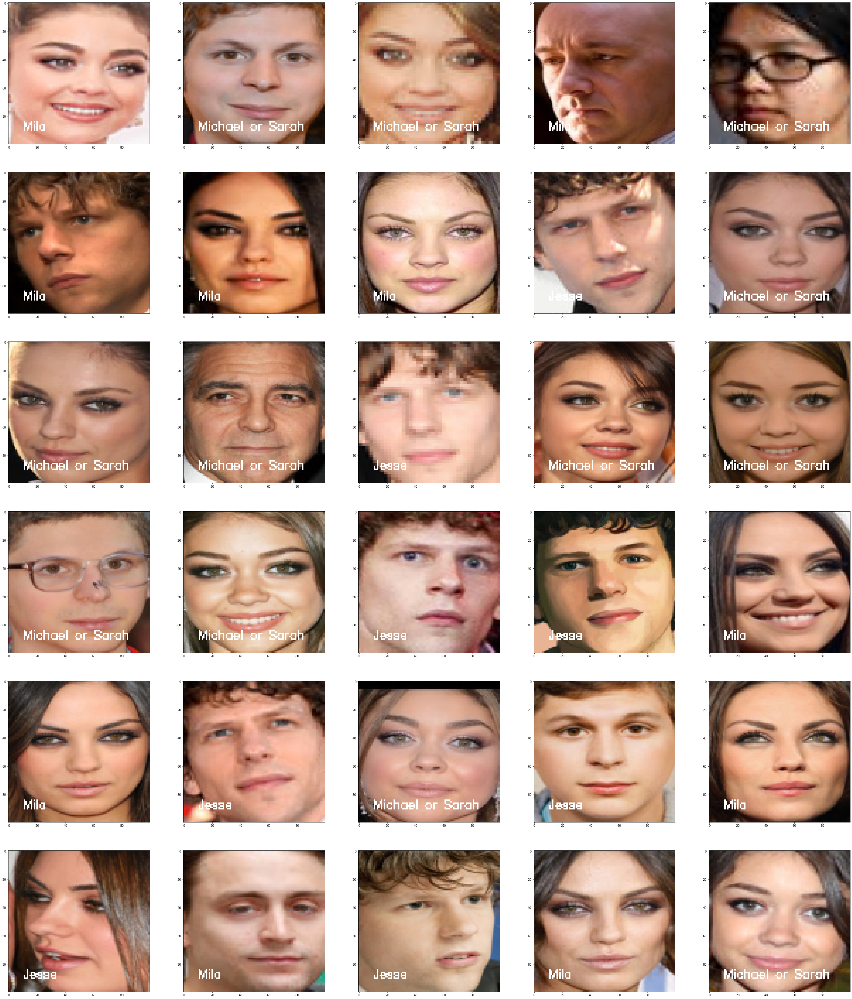

In [40]:
svm.test(X_test_pca[:,:ind+1],test_X,30,bestsvm,bestscaler)

**Code SVM Classifier for Multifaces**

In [41]:
# Steffi contributed to this part
class MultiSVMClassificationModel():
    def __init__(self, kernel = 'rbf'):
        self.model = SVC(kernel = kernel, probability=True)

    def fit(self, X, y, multiFace = False):
        #supporting multiple faces for a single image

        combinedX = []
        combinedy = []
        for idx, imgFaces in enumerate(X):
            if (multiFace or len(imgFaces) == 1) : #only add images to fit if there is a single face when multiFace == False
                for face in imgFaces:
                    combinedX.append(face)
                    combinedy.append(y[idx])

        self.model.fit(combinedX, combinedy)
        return self

    def predict(self, X):
        scores = []
        for imgFaces in X:
            if(len(imgFaces) > 0):
                scores.append(self.model.predict_proba(imgFaces))
            else:
                scores.append([[0,0,0]])
        reducedScore = [np.max(imgScore, axis=0) for imgScore in scores]
        labels = np.argmax(reducedScore,axis=1)

        return labels
    
    def scores(self, X):
        scores = []
        for imgFaces in X:
            if(len(imgFaces) > 0):
                scores.append(self.model.predict_proba(imgFaces))
            else:
                scores.append([[0,0,0]])
        return scores

    def __call__(self, X):
        return self.predict(X)

## 3.3: Random Forest Classifier
Random Forest is a supervised learning technique. The name 'forest' denotes the large amount of decision trees that are used to build such a model. Simply put, a random forest classifier will use many decision trees that each make a prediction about a certain sample. The prediction that's most common is the eventual final prediction of the random forest classifier. The power of these types of classifiers lies in the uncorrelated nature of each individual tree; if one tree wrongly predicts something, on average most trees will still be correct. <br>
For student who'd like to know more, here are some useful papers & articles:

https://williamkoehrsen.medium.com/random-forest-simple-explanation-377895a60d2d

https://link.springer.com/article/10.1023/A:1010933404324

https://www.jmlr.org/papers/volume13/biau12a/biau12a.pdf

**Code**

In [42]:
class RandomForestClassificationModel():
    def __init__(self):
        self.feature_set = []
        self.bestmodel = KNeighborsClassifier()
        self.lastModel = KNeighborsClassifier()
        self.train_y = []
        self.bestscaler = Normalizer()
        self.lastscaler = Normalizer()
        self.train_prec = []
        self.test_prec = []
        self.train_rec = []
        self.test_rec = []
        self.train_f1 = []
        self.test_f1 = []
        self.train_acc = []
        self.test_acc = []
        self.ind = 0
        
    def fit(self,feature_set, y_set):
        self.feature_set = feature_set
        self.train_y = y_set
        rf_models = []
        scalers = []
        for i in range(len(self.feature_set[0])):
            X_rf = self.feature_set[:,0:i+1]
            X_train_rf, X_test_rf, y_train_rf, y_test_rf = train_test_split(X_rf, self.train_y,test_size=0.25,random_state=42)
            scaler = Normalizer()
            X_train_rf = scaler.fit_transform(X_train_rf)
            X_test_rf = scaler.transform(X_test_rf)
            scalers.append(scaler)
            # Fit k-NN classifier and make predictions
            rf = RandomForestClassifier()
            rf.fit(X_train_rf, y_train_rf)
            y_pred_train = rf.predict(X_train_rf)
            y_pred_test = rf.predict(X_test_rf)
            self.train_prec.append(precision_score(y_train_rf, y_pred_train,average='weighted'))
            self.test_prec.append(precision_score(y_test_rf, y_pred_test,average='weighted'))
            self.train_rec.append(recall_score(y_train_rf, y_pred_train, average='weighted'))
            self.test_rec.append(recall_score(y_test_rf, y_pred_test, average='weighted'))
            self.train_f1.append(f1_score(y_train_rf, y_pred_train, average='weighted'))
            self.test_f1.append(f1_score(y_test_rf, y_pred_test, average='weighted'))
            self.train_acc.append(accuracy_score(y_train_rf, y_pred_train))
            self.test_acc.append(accuracy_score(y_test_rf, y_pred_test))
            rf_models.append(rf)
            
        print(len(self.test_f1))
        self.ind = np.argmax(self.test_f1)
        print(f'Ideal number of dimensions for this feature set is {self.ind} with a score of {max(self.test_f1)} ')
        self.bestmodel = knns[self.ind]
        self.bestscaler = scalers[self.ind]
        self.lastmodel = knns[-1]
        self.lastscaler = scalers[-1]
        return rf_models, scalers, self.bestmodel,self.bestscaler, self.ind
    
    def plot_scores(self):
        # Plot accuracy by n_neighbors
        plt.figure(figsize=(8, 6))
        plt.plot(range(1,len(self.feature_set[0])+1), self.train_prec, label='Train precision Score')
        plt.plot(range(1,len(self.feature_set[0])+1), self.test_prec, label='Test precision Score')
        plt.ylabel('precision Score')
        plt.xlabel('# of Principal Components')
        plt.legend()
        plt.show()
        plt.figure(figsize=(8, 6))
        plt.plot(range(1,len(self.feature_set[0])+1), self.train_rec, label='Train recall Score')
        plt.plot(range(1,len(self.feature_set[0])+1), self.test_rec, label='Test recall Score')
        plt.ylabel('recall Score')
        plt.xlabel('# of Principal Components')
        plt.legend()
        plt.show()
        plt.figure(figsize=(8, 6))
        plt.plot(range(1,len(self.feature_set[0])+1), self.train_f1, label='Train f1 Score')
        plt.plot(range(1,len(self.feature_set[0])+1), self.test_f1, label='Test f1 Score')
        plt.ylabel('f1 Score')
        plt.xlabel('# of Principal Components')
        plt.legend()
        plt.show()
        plt.figure(figsize=(8, 6))
        plt.plot(range(1,len(self.feature_set[0])+1), self.train_acc, label='Train accuracy Score')
        plt.plot(range(1,len(self.feature_set[0])+1), self.test_acc, label='Test accuracy Score')
        plt.ylabel('accuracy Score')
        plt.xlabel('# of Principal Components')
        plt.legend()
        plt.show()
        
    def predict(self, image, image_pca):
        plt.imshow(image)
        image_trans = self.bestscaler.transform(image_pca.reshape(1,-1))
        pred = self.bestmodel.predict(image_trans)
        if pred == 0:
            print('Michael or Sarah')
        elif pred == 1:
            print('Jesse')
        else:
            print('Mila')
    
    def test(self, test_set_pca, test_set_ims, n_images, knn,scaler):
        samples_pca = []
        samples_ims = []
        show_ims=[]
        for i in range(n_images):
            id = np.random.choice(np.arange(len(test_set_pca)), replace=False)
            samples_pca.append(test_set_pca[id])
            samples_ims.append(test_set_ims[id])
        test_trans = scaler.transform(samples_pca)
        pred = knn.predict(test_trans)
        for i in range(len(pred)):
            if pred[i] == 0:
                text = 'Michael or Sarah'
            elif pred[i] == 1:
                text = 'Jesse'
            else:
                text = 'Mila'
            image = samples_ims[i]
            image = image/255.0
            font = cv2.FONT_HERSHEY_SIMPLEX
            org = (10, 90)
            fontScale = 0.28
            color = (255, 255, 255)
            thickness = 1
            cv2.putText(image, text, org, font, fontScale, 
                     color, thickness, cv2.LINE_AA)
            show_ims.append(image)
        plot_image_sequence(show_ims, n=n_images, imgs_per_row=5)

    def __call__(self,feature_set, bestmodel = False):
        if not bestmodel:
            fs_trans = self.lastscaler.transform(feature_set)
            y = self.lastmodel.predict(fs_trans)
            return y
        else:
            print(len(feature_set[:self.ind+1]))
            fs_trans = self.bestscaler.transform(feature_set[:self.ind+1])
            y = self.bestmodel.predict(fs_trans)
            return y

124
Ideal number of dimensions for this feature set is 37 with a score of 0.9500339529751295 


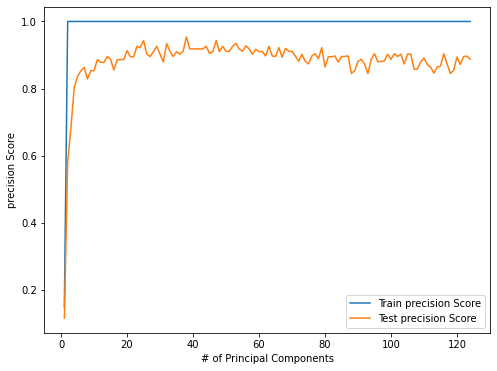

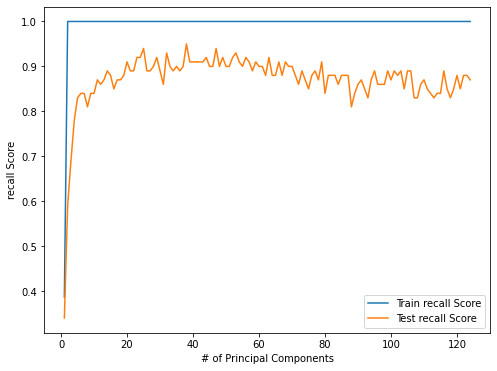

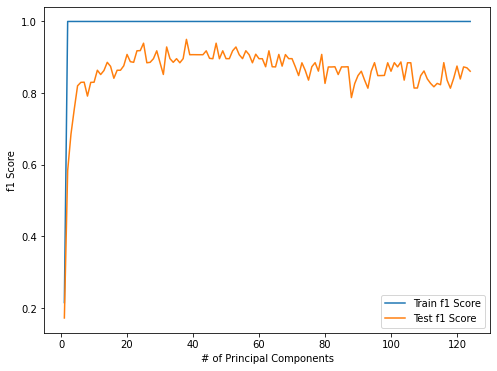

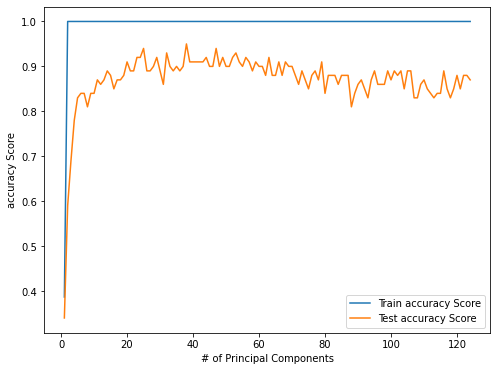

In [43]:
rf = RandomForestClassificationModel()
rf_models, scalers, bestrf, bestscaler, ind = rf.fit(X_train_pca, train_y)
rf.plot_scores()

Here are some examples of predictions by our random forest-model:

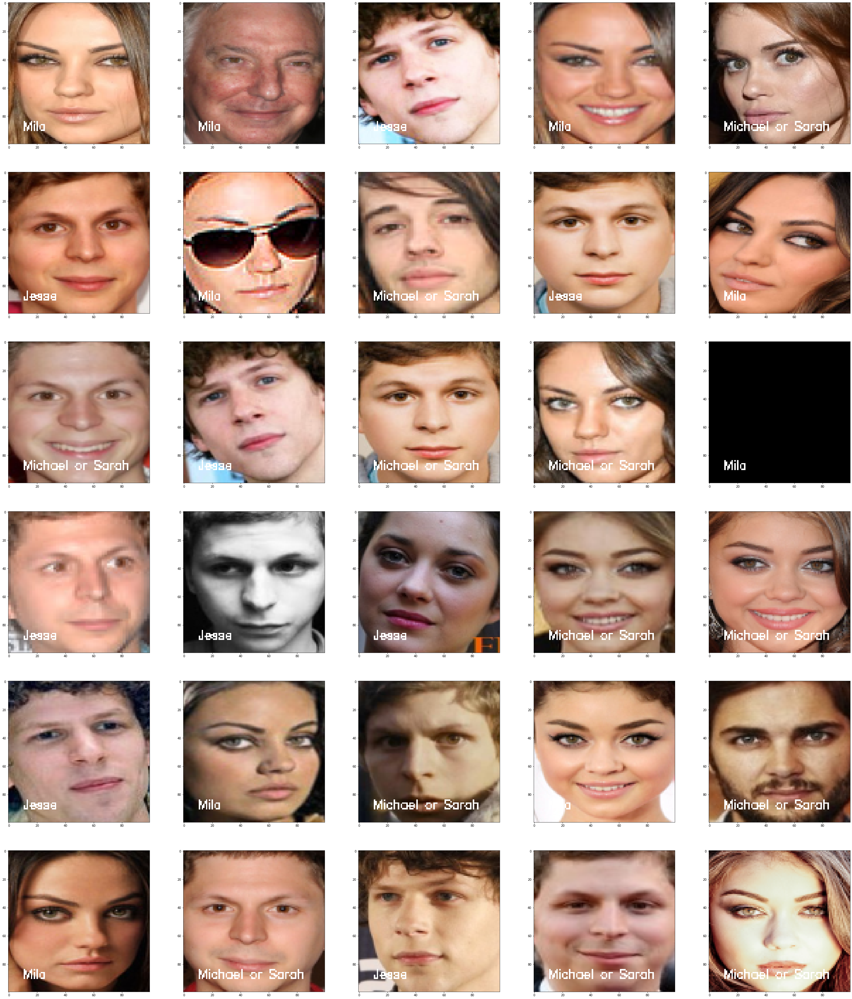

In [44]:
rf.test(X_test_pca[:,:ind+1],test_X,30,bestrf,bestscaler)

## 3.4. favorite classifier

Just by looking at the graphs it is obvious SVM produces by far the best results.

## 3.4. Discussion

So we have used the naive classifier as the baseline case, and applied KNN and SVM as classifiers for this face recognition exercise. Both KNN and SVM tend to be used a lot in the academic literature and in practice. It should be noted that one could use other classifiers as well. As the no-free-lunch theorem is machine learning states, one could try multiple classifiers and take the best one. However, one should not try different classifiers for the sake of trying different classifiers. One could apply more advanced machine learning algorithms. One should, however, look for efficiency and computational time. SVMs have the great advantage of limited computational resources it requires (relative to, for example, neural networks). 

Both K-Nearest-Neighbor (KNN) and Support-Vector-Machine (SVM) classification are widely used in the literature and in practice. A paper of Kim et al. (2012) compares KNN and SVM in image classification and finds that SVM tends to outperform. Somne studies have investigated the combination of KNN and SVM for image classification instead of comparing them. Alimjan et al. (2018) investigates a combinatorial algorithm of KNN and SVM, and they find that the proposed combinatorial algorithm has advantages over the conventional KNN for eliminating the 𝑘 parameter selection problem and reducing heavy learning time.

For the students interested, paper of Kim et al. (2012):
http://www.wseas.us/e-library/conferences/2012/CambridgeUSA/MATHCC/MATHCC-18.pdf

For the students interested, paper of Alimjan et al. (2012):
https://www.worldscientific.com/doi/abs/10.1142/S0218001418590127


# 4. Experiments

## 4.0. Example of the pipeline: PCA and KNN

We start with basic feature extraction through PCA and basic classification via KNN (as discussed above). So we extract features via PCA and then try to train a KNN model on these features in order to be able to classify images correctly. 

In [45]:
# Steffi contributed to this part
preprocessor = MTCNNPreprocessor(face_size = FACE_SIZE)
feature_extractor = PCAFeatureExtractor() 
classifier = kNNClassificationModel()

# Augment the data
train_aug = augment_data(train)
# Apply face detection
train_X, train_y = preprocessor(train_aug), train_aug['class'].values
# Split the data for cross validation
X_train_exp, X_valid_exp, y_train_exp, y_valid_exp = train_test_split(train_X, train_y,test_size=0.25,random_state=42)
# Train the model on the features 
classifier.fit(feature_extractor(X_train_exp), y_train_exp)

# model/final pipeline
model = lambda X: classifier(feature_extractor(X))

Ideal number of dimensions for this feature set is 30


This model is evaluated on performance using 4 different metrics:

In [46]:
# evaluate performance of the model on the validation set
valid_y_star = model(X_valid_exp)
check_performance(valid_y_star, y_valid_exp)

Accuracy score: 0.996
Precision score: 0.9960439560439561
Recall score: 0.996
F1 score: 0.9960001207620084


(0.996, 0.9960439560439561, 0.996, 0.9960001207620084)

In [47]:
# predict the labels for the test set 
test_y_star = model(test_X)

## 4.1. PCA With SVM


In [48]:
classifier = SVMClassificationModel()
# We can re-use the data from previous experiment
# Train the model on the features 
classifier.fit(feature_extractor(X_train_exp), y_train_exp)

# model/final pipeline
model = lambda X: classifier(feature_extractor(X))

124
Ideal number of dimensions for this feature set is 22 with a score of 0.9973315271730366 


This model is evaluated on performance using 4 different metrics:

In [49]:
valid_y_star = model(X_valid_exp)
check_performance(valid_y_star, y_valid_exp)

Accuracy score: 0.992
Precision score: 0.9920182687820708
Recall score: 0.992
F1 score: 0.9919919011705942


(0.992, 0.9920182687820708, 0.992, 0.9919919011705942)

## 4.2. PCA With Random Forest

In [50]:
classifier = RandomForestClassificationModel()
# We can re-use the data from previous experiment
# Train the model on the features 
classifier.fit(feature_extractor(X_train_exp), y_train_exp)

# model/final pipeline
model = lambda X: classifier(feature_extractor(X))

124
Ideal number of dimensions for this feature set is 23 with a score of 0.9919949236946505 


This model is evaluated on performance using 4 different metrics:

In [51]:
valid_y_star = model(X_valid_exp)
check_performance(valid_y_star, y_valid_exp)

Accuracy score: 0.428
Precision score: 0.42900487582592844
Recall score: 0.428
F1 score: 0.4269107303579241


(0.428, 0.42900487582592844, 0.428, 0.4269107303579241)

## 4.3. FaceNet With SVM

In [52]:
preprocessor = MultiMTCNNPreprocessor(face_size=FACE_SIZE,conf_threshold=0.95)
feature_extractor = MultiFaceNetFeatureExtractor()
classifier = MultiSVMClassificationModel()

# Augment the data
train_aug = augment_data(train)
# Apply face detection
train_X, train_y = preprocessor(train_aug), train_aug['class'].values
# Remove images where no face is detected from trainingset:
train_X, train_y = list(zip(*[(faces, train_y[idx]) for idx, faces in enumerate(train_X) if len(faces) > 0]))
# Split the data for cross validation
X_train_exp, X_valid_exp, y_train_exp, y_valid_exp = train_test_split(train_X, train_y,test_size=0.25,random_state=42)

features_train = feature_extractor(X_train_exp)
classifier.fit(features_train,  y_train_exp, multiFace=False) # Fit classifier model with only 1-face images
# model/final pipeline
model = lambda X: classifier(feature_extractor(X))

  0%|          | 0.00/107M [00:00<?, ?B/s]

In [53]:
# evaluate performance of the model on the training set
valid_y_star = model(X_valid_exp)

check_performance(valid_y_star, y_valid_exp)

Accuracy score: 0.9777327935222672
Precision score: 0.9794577179677253
Recall score: 0.9777327935222672
F1 score: 0.977845866997883


(0.9777327935222672, 0.9794577179677253, 0.9777327935222672, 0.977845866997883)

It is able to fit 97% of the training set.

In [54]:
test_X = preprocessor(test)
test_y_star = model(test_X)

## 4.2. FaceNet Multifaces With SVM

Now let's compare what happens when we don't choose the first face and instea create a classifier with thefaces we're certain, and from this classifier we then decide which face in the picture is the more likely to be the correct one.
Using again Facenet and SVM.

In [55]:
preprocessor = MultiMTCNNPreprocessor(face_size=FACE_SIZE,conf_threshold=0.95)
feature_extractor = MultiFaceNetFeatureExtractor()
classifier = MultiSVMClassificationModel()

# Augment the data
train_aug = augment_data(train)
# Apply face detection
train_X, train_y = preprocessor(train_aug), train_aug['class'].values
# Remove images where no face is detected from trainingset:
train_X, train_y = list(zip(*[(faces, train_y[idx]) for idx, faces in enumerate(train_X) if len(faces) > 0]))
# Split the data for cross validation
X_train_exp, X_valid_exp, y_train_exp, y_valid_exp = train_test_split(train_X, train_y,test_size=0.25,random_state=42)

features_train = feature_extractor(X_train_exp)
classifier.fit(features_train, y_train_exp, multiFace=False) # Fit classifier model with only 1-face images
labels = classifier.predict(features_train)
scores = classifier.scores(features_train)

for idx,imageScore in enumerate(scores): #reduce images where multiple faces are detected to the face(s) matched with the label
    features_train[idx] = features_train[idx][np.where(imageScore[:,y_train_exp[idx]] > 0.7)]

classifier.fit(features_train, y_train_exp, multiFace=True) #re-fit classification model including filtered images (=only face matching the label) with multiple faces


In [56]:
# model/final pipeline
model = lambda X: classifier(feature_extractor(X))

# evaluate performance of the model on the training set
valid_y_star = model(X_valid_exp)

check_performance(valid_y_star, y_valid_exp)

Accuracy score: 0.9919028340080972
Precision score: 0.9921427500374869
Recall score: 0.9919028340080972
F1 score: 0.9919201818049106


(0.9919028340080972,
 0.9921427500374869,
 0.9919028340080972,
 0.9919201818049106)

With this multi faces it is able to correctly fit 98% of the training set. Which is an improvement from when it was just choosing the first found face.

In [57]:
#test_X = preprocessor(test)
test_y_star = model(test_X)

# 5. Discussion & Publishing of Results

**5.1 Discussion of Results**

This is a tutorial about feature representations meant for master students that are interested in a hands-on introduction on the algorithms that are implemented in the aspect of computer vision. We learned about the complete process of image recognition with a practical dataset and tried to improve our techniques using well-known methods inspired in face recognition.

In the first part of our tutorial, we imported our packages, loaded the data and performed necessary pre-processing of the images. In this pre-processing stage we started with the HAAR face detector. Next, we tried several alternatives such as DNN, CNN and MTCNN. Finally, we also included augmentation of the training data by rotating the face images, splitting the face images with multiple faces and removing images not containing any faces.

In the second part, we explained how to work with feature representations using handcrafted features (HOG) and features learned from data (PCA). Here we extracted features from the images to be used in our classifiers. To visualize these feature representations, we utilized tools like t-SNE plots, Eigenface plots and Feature Space plots. Finally, we provided 2 improving procedures: the first one being LDA as a feature extractor and Google’s FaceNet as the second. We can conclude that our choice on which one to use depends on what our goal is: do we want to separate our data by maximizing variability (PCA) or by maximizing inter-class distance (LDA).

After this part, we checked the performance of our system and used a variety of evaluation measures and cross-validation: accuracy, precision, recall & F1.

In the fourth part of our tutorial, we compared feature representation techniques in context of image classification. We started with two popular classifiers in face recognition: KNN and an extended version of SVM. We also included the Random Forest algorithm as an improvement of the previous two classifiers. Finally, we compare the classifiers and select the best one for the purpose of this face recognition exercise.

In the last part we tried to improve our face recognition system with certain algorithms in hopes of increasing performance. Although we can’t make solid conclusions about generalisability of the model, we do observe enhanced performance with the FaceNet Multifaces + SVM, where we see that it is able to correctly predict almost 99% of the validation set. This is an improvement from when it was just choosing the first found face.
Generally, we know that there is always a trade-off between computational costs and accuracy. CNN’s have indeed gained popularity in the last years and we could thus increase the size of the training sets or the capacity of the networks that we use, but remain with the problem as we observe here that CNN architectures are slow to train and deploy. 
If we did have more time to implement improvements in our currently used algorithms, we would have also included OpenFace, a deep convolutional neural network, because it works great even in different environments. It is similar to our FaceNet algorithm but with a reduced amount of parameters that discards more triplets from being used in training. On the other hand, it would have been beneficial to include more hybrid techniques to explore and experiment with, as these seem to have better accuracy than most of the currently used methods out there. 


**5.2 Submission of Results**

Finally, we submit our results (in a CSV file) to the Kaggle competition via the following code.

In [58]:
submission = test.copy().drop('img', axis = 1)
submission['class'] = test_y_star
submission.to_csv('submission_3.csv')

I hope you enjoyed this tutorial on face recognition!

Stay tuned for the next tutorial (assignment)!

**___________________**